1. Your algo trading bot’s performance: such as return, win rate, # trade, sharpe ratio

2. Trade set up: such as threshold, tp, sl, hp, amount

3. Top 5 features based on the shap

4. Strategy/yhreshold analysis: i leave this on you how to explain
- Enter a trade when the predicted signal exceeds a chosen threshold.
- Hold the trade for a maximum of holding_period bars (e.g., minutes, hours, or days).
- Exit early if a take profit or stop loss condition is met.
- liquidate investment after holding period

5. Model’s performance and grid search: i leave it on you jow to explain

6. Your data: assets plus time period plus frequency
- Total Number of Stocks & ETF: 11
- Stocks: ['AAPL', 'AMD', 'AMZN', 'META', 'MSFT', 'NFLX', 'NKE', 'NVDA', 'TSLA', 'XOM']
- ETF: ['SPY']
- interval: 1 min
- period: 2 years (January 2023 - December 2024)

In [8]:
from setup import DataLoader
from steps import FILENAME
import os
import pandas as pd

''''''

data_loader = DataLoader(is_google_colab=False)
file_dict = data_loader.get_data_filepath_dict()
print(f'Total Number of Stocks & ETF: {len(file_dict.keys())}')
print(f'Stocks: {[i for i in list(file_dict.keys()) if i != "SPY"]}')
print(f'ETF: {[i for i in list(file_dict.keys()) if i == "SPY"]}')

algo_trading_bot_performance_colnames = ['total_return_percentage', 'win_rate_percentage', 'num_trades', 'sharpe_ratio', 'holding_period', 'threshold']

for stock_ticker in file_dict:
    # stock_ticker = 'AAPL'
    print(f'{"=" * 50}{stock_ticker}{"=" * 50}')
    # print(stock_ticker)
    stock_dir = os.path.join(data_loader.intermediate_data_dir, stock_ticker)
    
    STRATEGY_RESULT_TEST_1_fp = os.path.join(stock_dir, FILENAME.STRATEGY_RESULT_TEST_1)
    if os.path.exists(STRATEGY_RESULT_TEST_1_fp):
        startegy_data_test_1 = pd.read_csv(STRATEGY_RESULT_TEST_1_fp, index_col='Unnamed: 0')

    startegy_data_test_1['total_return_percentage'] = startegy_data_test_1['total_return'] * 100
    startegy_data_test_1['win_rate_percentage'] = startegy_data_test_1['win_rate'] * 100

    top_10_performance_df = startegy_data_test_1.sort_values(by=['sharpe_ratio', 'win_rate', 'total_return'], ascending=False).head(10)
    # print(f'Columns: {top_10_performance_df.columns}')
    best_sharpe_ratio_performance = startegy_data_test_1.sort_values(by='sharpe_ratio', ascending=False).head(1)
    best_win_rate_performance = startegy_data_test_1.sort_values(by='win_rate', ascending=False).head(1)
    best_total_return_performance = startegy_data_test_1.sort_values(by='total_return', ascending=False).head(1)
    print(f'# Top 10 performance based on Sharpe Ratio, Win Rate, Total Returns: \n{top_10_performance_df[algo_trading_bot_performance_colnames]}')
    print(f'# Top performance based on Sharpe Ratio: \n{best_sharpe_ratio_performance[algo_trading_bot_performance_colnames]}')
    print(f'# Top performance based on Win Rate: \n{best_win_rate_performance[algo_trading_bot_performance_colnames]}')
    print(f'# Top performance based on Total Return: \n{best_total_return_performance[algo_trading_bot_performance_colnames]}')
        

Total Number of Stocks & ETF: 11
Stocks: ['AAPL', 'AMD', 'AMZN', 'META', 'MSFT', 'NFLX', 'NKE', 'NVDA', 'TSLA', 'XOM']
ETF: ['SPY']
==================================================AAPL==================================================
# Top 10 performance based on Sharpe Ratio, Win Rate, Total Returns: 
    total_return_percentage  win_rate_percentage  num_trades  sharpe_ratio  \
55                26.744012            56.179775          89      0.161208   
35                29.297975            55.339806         103      0.157574   
15                33.090409            53.968254         126      0.156625   
25                35.045462            67.549669         151      0.150773   
45                34.321236            67.549669         151      0.147747   
5                 32.815324            62.941176         170      0.134695   
0                 31.182466            52.016129         248      0.107071   
20                29.890287            52.765957         235      0.1

# Top 10 performance based on Sharpe Ratio, Win Rate, Total Returns: 
    total_return_percentage  win_rate_percentage  num_trades  sharpe_ratio  \
49                34.572984            73.600000         125      0.229372   
59                44.487051            60.240964          83      0.226040   
39                43.935635            60.674157          89      0.225176   
9                 24.434077            65.540541         148      0.195539   
29                21.522875            69.841270         126      0.169382   
19                33.075154            54.867257         113      0.159598   
54                34.553151            42.105263         114      0.157111   
34                32.827555            47.008547         117      0.152804   
4                 19.454174            55.665025         203      0.140843   
58                39.213941            53.459119         159      0.128271   

    holding_period  threshold  
49             240        0.9  
59     

In [7]:
from setup import DataLoader
from steps import FILENAME
import os
import pandas as pd

''''''

data_loader = DataLoader(is_google_colab=False)
file_dict = data_loader.get_data_filepath_dict()
print(f'Total Number of Stocks & ETF: {len(file_dict.keys())}')
print(f'Stocks: {[i for i in list(file_dict.keys()) if i != "SPY"]}')
print(f'ETF: {[i for i in list(file_dict.keys()) if i == "SPY"]}')

algo_trading_bot_performance_colnames = ['total_return_percentage', 'win_rate_percentage', 'num_trades', 'sharpe_ratio', 'holding_period']

for stock_ticker in file_dict:
    # stock_ticker = 'AAPL'
    print(f'{"=" * 50}{stock_ticker}{"=" * 50}')
    # print(stock_ticker)
    stock_dir = os.path.join(data_loader.intermediate_data_dir, stock_ticker)
    
    STRATEGY_RESULT_TEST_1_fp = os.path.join(stock_dir, FILENAME.STRATEGY_RESULT_TEST_1)
    if os.path.exists(STRATEGY_RESULT_TEST_1_fp):
        startegy_data_test_1 = pd.read_csv(STRATEGY_RESULT_TEST_1_fp, index_col='Unnamed: 0')

    startegy_data_test_1['total_return_percentage'] = startegy_data_test_1['total_return'] * 100
    startegy_data_test_1['win_rate_percentage'] = startegy_data_test_1['win_rate'] * 100

    performance_df = startegy_data_test_1.sort_values(by=['sharpe_ratio', 'win_rate', 'total_return'], ascending=False)
    print(performance_df)


Total Number of Stocks & ETF: 11
Stocks: ['AAPL', 'AMD', 'AMZN', 'META', 'MSFT', 'NFLX', 'NKE', 'NVDA', 'TSLA', 'XOM']
ETF: ['SPY']
==================================================AAPL==================================================
    holding_period  take_profit  stop_loss  threshold  num_trades  win_rate  \
55             240        0.010     -0.010        0.5          89  0.561798   
35             120        0.010     -0.010        0.5         103  0.553398   
15              60        0.010     -0.010        0.5         126  0.539683   
25             120        0.005     -0.010        0.5         151  0.675497   
45             240        0.005     -0.010        0.5         151  0.675497   
5               60        0.005     -0.010        0.5         170  0.629412   
0               60        0.005     -0.005        0.5         248  0.520161   
20             120        0.005     -0.005        0.5         235  0.527660   
40             240        0.005     -0.005        0.

```python
target y: average percentage change (from current price) in next 120 periods (2 hours) > 0.01
target y can be 0 or 1

best 5 feature: 
1. price_above_vwap_1920: well distributed, top feature of multiple stock, lower value indicate higher Y value (1), higher -> Y (0). 
similar characteristics for most of the stock. 
2. min_close_120: top feature for most of the stock, lower value indicate higher Y value (1), higher -> Y (0). 
similar characteristics for most of the stock. 
3. downside_deviation period(480, 1920): top feature for most of the stock. low -> Y(1), high -> Y(0). for some period behavior flips. 
4. ATR period(960*, 1920): top feature for most of the stock. low -> Y(1), high -> Y(0).
5. Sortino_ratio_1920: low -> Y(1), high -> Y(0)


amd: 
bollinger_width_1920: low -> Y(0), high -> Y(1)
min_close_120: low -> Y(1), high -> Y(0)
downside_deviation_1920: low -> Y(1), high -> Y(0)
downside_deviation_960: low -> Y(0), high -> Y(1)
Sortino_ratio_1920: low -> Y(1), high -> Y(0)
bollinger_width: low -> Y(0), high -> Y(1)

amzn: 
min_close_120: low -> Y(1), high -> Y(0)
downside_deviation_1920: low -> Y(1), high -> Y(0)
bollinger_width_1920: low -> Y(0), high -> Y(1)
max_close_1920: low -> Y(1), high -> Y(0)
atr_960: low -> Y(1), high -> Y(0)

meta: 
min_close_120: low -> Y(1), high -> Y(0)
atr_960: low -> Y(1), high -> Y(0)
downside_deviation_480: low -> Y(1), high -> Y(1)

msft:
downside_deviation_1920: low -> Y(1), high -> Y(0)
sma_cont_120: low -> Y(1), high -> Y(0)
bollinger_width_960: low -> Y(1), high -> Y(0)
rate_close_gt_open_1920 -> low -> Y(1), high -> Y(0)

nflx: 
atr_1920: low -> Y(1), high -> Y(0)
min_close_480: low -> Y(1), high -> Y(0)
downside_deviation_480: low -> Y(1), high -> Y(0)
downside_deviation_1920: low -> Y(1), high -> Y(0)
price_above_vwap_960: low -> Y(1), high -> Y(0)  [very well distributed]

nke: 
momentum_960: low -> Y(1), high -> Y(0)

nvda: 
downside_deviation_960: low -> Y(1), high -> Y(0)
Sortino_ratio_1920: low -> Y(1), high -> Y(0)
downside_deviation_1920: low -> Y(1), high -> Y(0)
price_above_vwap_240: low -> Y(1), high -> Y(0)  [very well distributed]
binary_sma_crossover_120_240: low -> Y(0), high -> Y(1)

tsla: 
binary_sma_crossover_1920_3840: low -> Y(0), high -> Y(1)
atr_1920: low -> Y(0), high -> Y(1)
min_close_120: low -> Y(1), high -> Y(0)

xom: 
min_close_120: low -> Y(1), high -> Y(0)
atr_960: low -> Y(1), high -> Y(0)
downside_deviation_960: low -> Y(0), high -> Y(1)
price_above_vwap_1920: low -> Y(1), high -> Y(0)  [very well distributed]
min_close_480: low -> Y(0), high -> Y(1)










```

In [3]:
from steps import RUN_SETUP
run_setup = RUN_SETUP()
param = run_setup.params.get('_run_strategy')
trade_setup_columns = ['holding_periods', 'take_profits', 'stop_losses', 'thresholds', 'amount']


# trade_setup_df['holding_periods'] = param['holding_periods']
# trade_setup_df['take_profits'] = param['take_profits']
# trade_setup_df['stop_losses'] = param['stop_losses']
# trade_setup_df['thresholds'] = param['thresholds']

print(f'2. Trade Setup: ')
for k in param.keys():
    if k in trade_setup_columns:
        if k == 'amount':
            print(f'{k}: {[str(i * 100) + "%" for i in param[k]]}')
        else:
            print(f'{k}: {param[k]}')
# print(f'{param[]}')
# param.keys()


2. Trade Setup: 
holding_periods: [60, 120, 240]
take_profits: [0.005, 0.01]
stop_losses: [-0.005, -0.01]
thresholds: [0.5, 0.6, 0.7, 0.8, 0.9]
amount: ['10.0%', '20.0%', '30.0%']


Total Number of Stocks & ETF: 11
Stocks: ['AAPL', 'AMD', 'AMZN', 'META', 'MSFT', 'NFLX', 'NKE', 'NVDA', 'TSLA', 'XOM']
ETF: ['SPY']
==================================================AAPL==================================================


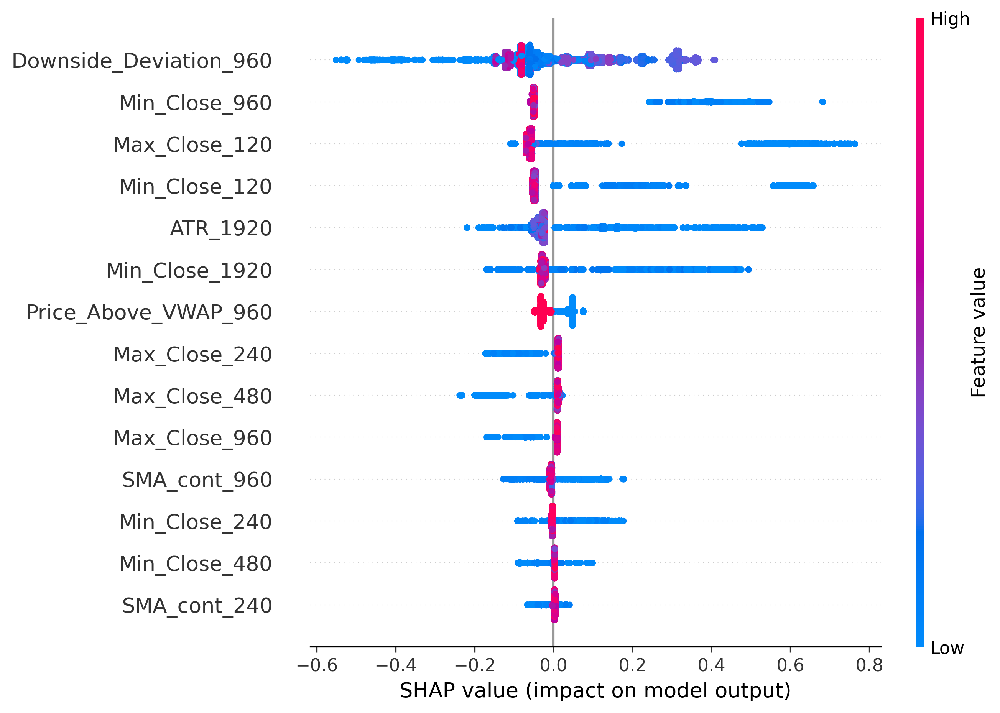

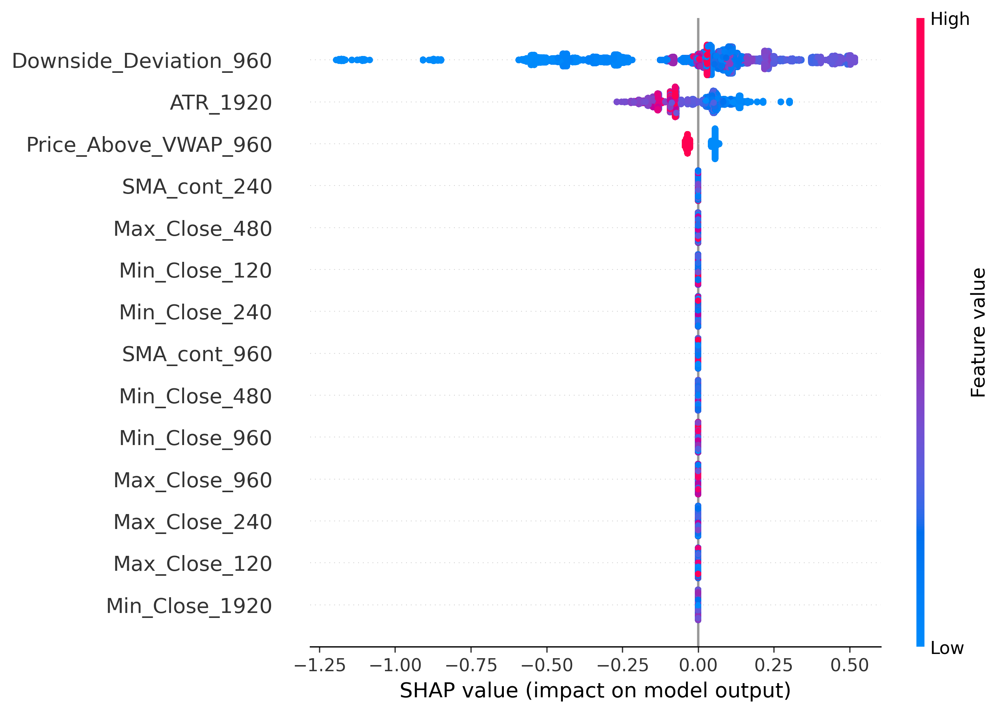

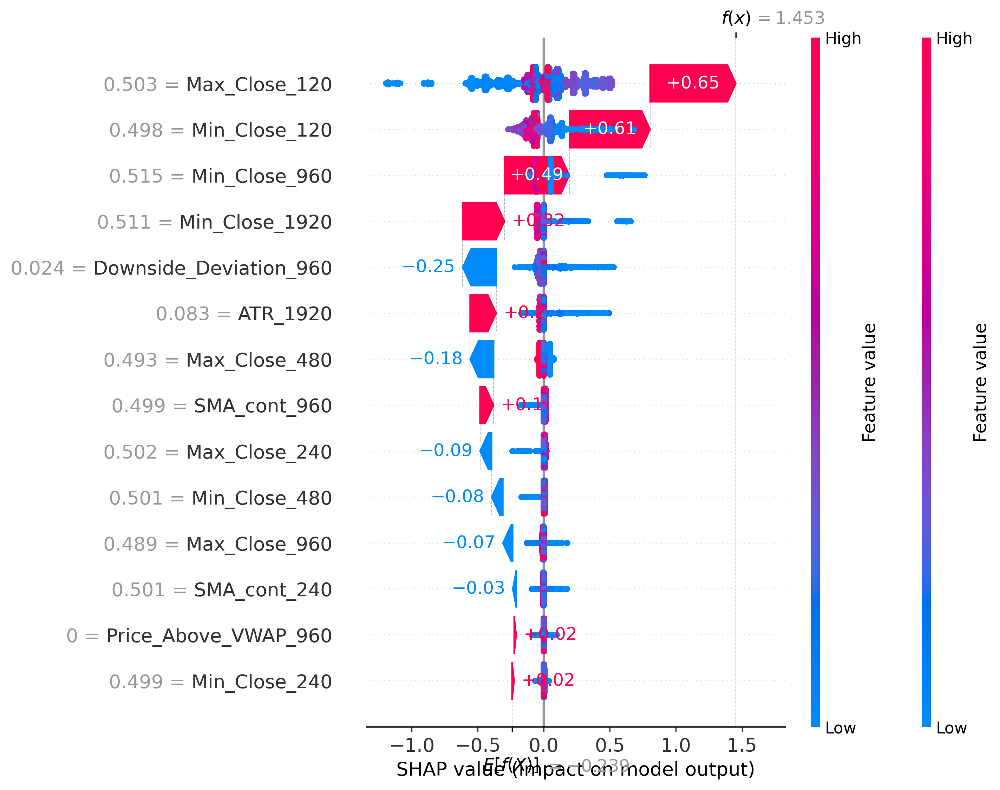

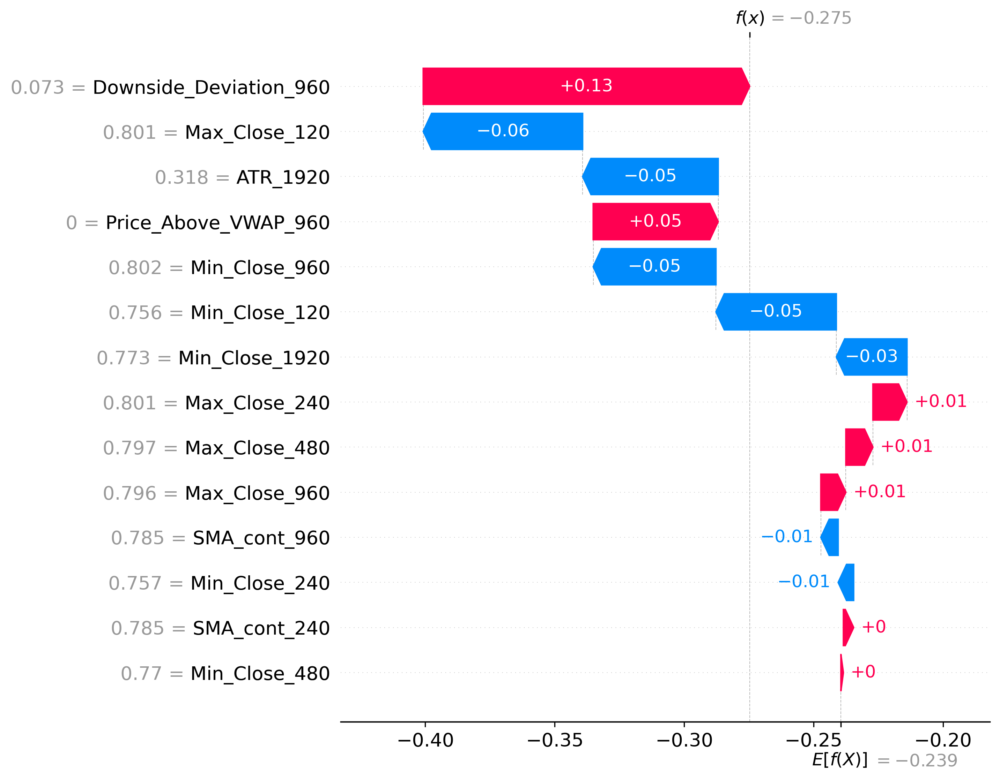

==================================================AMD==================================================


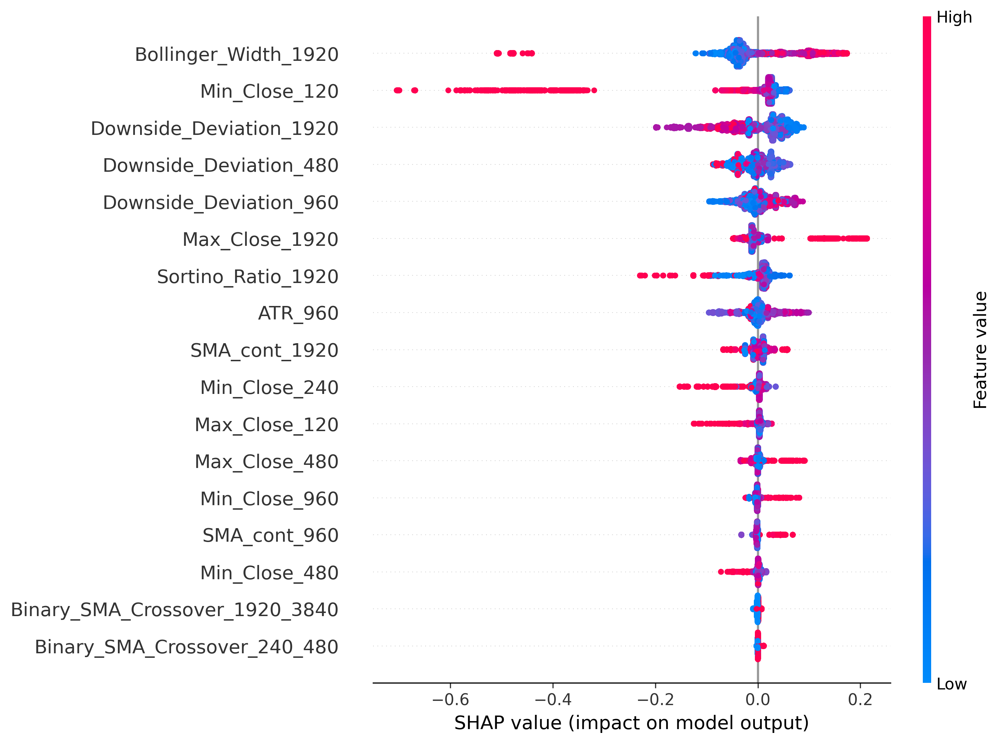

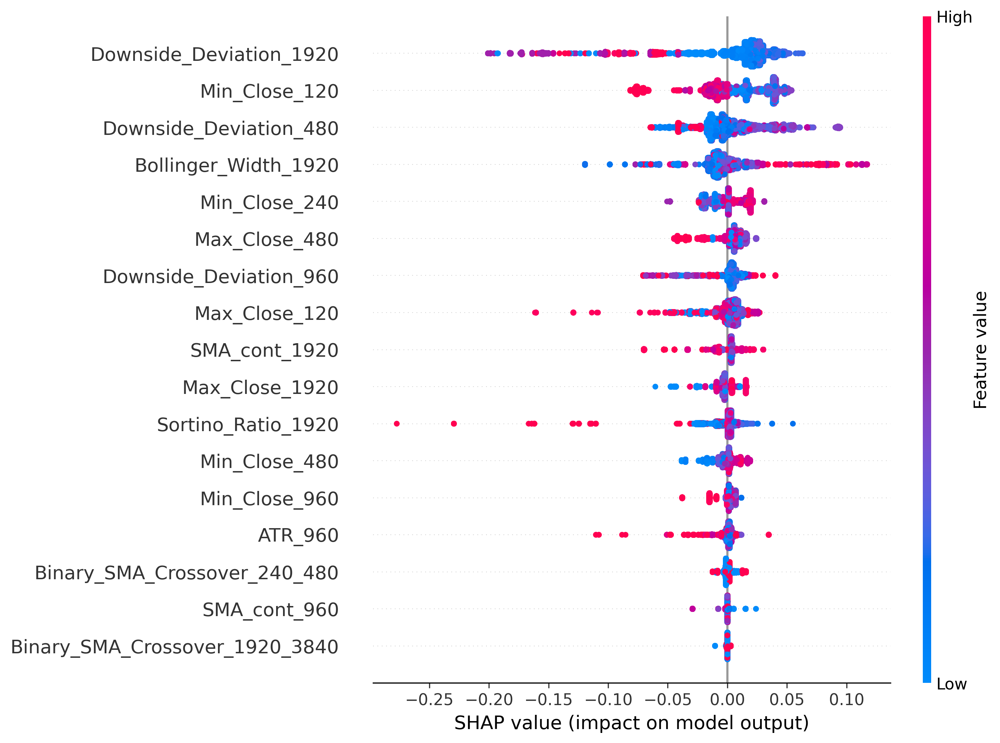

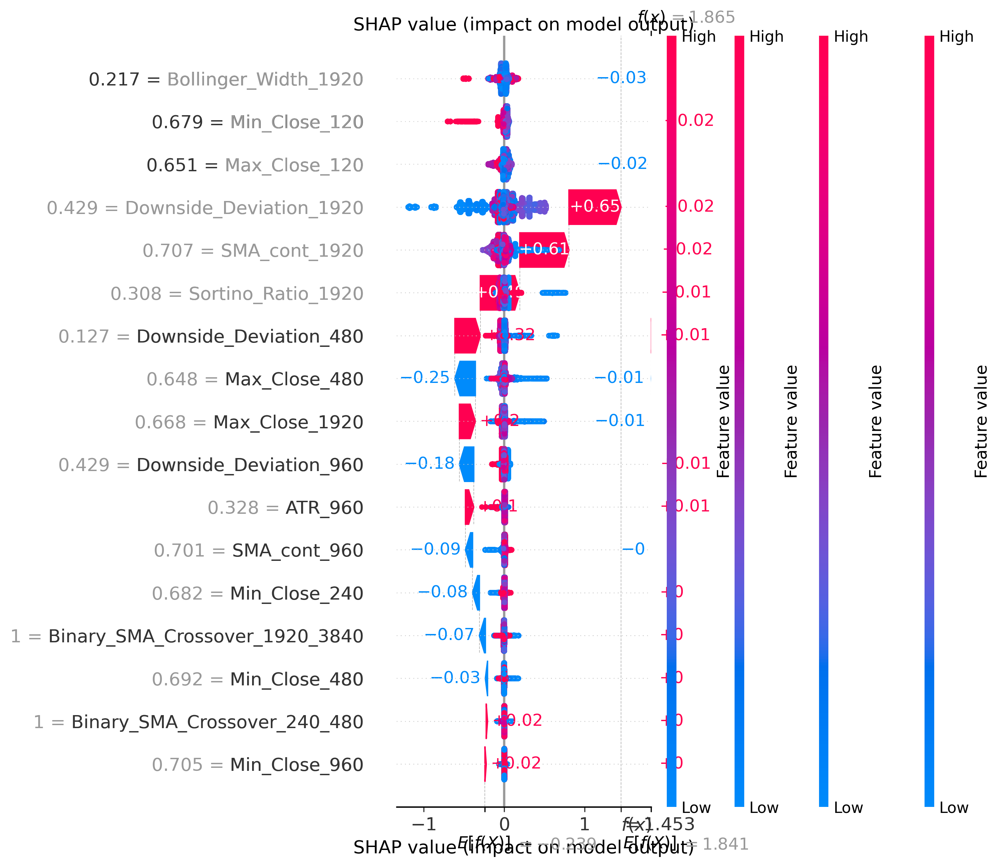

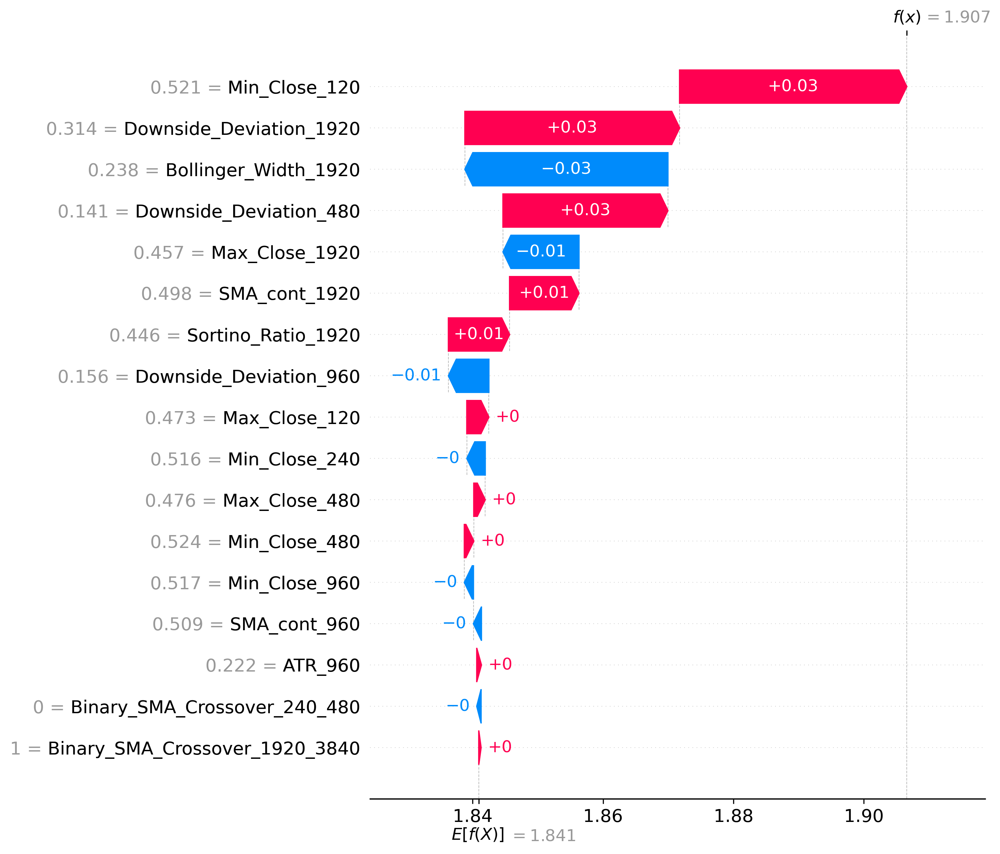

==================================================AMZN==================================================


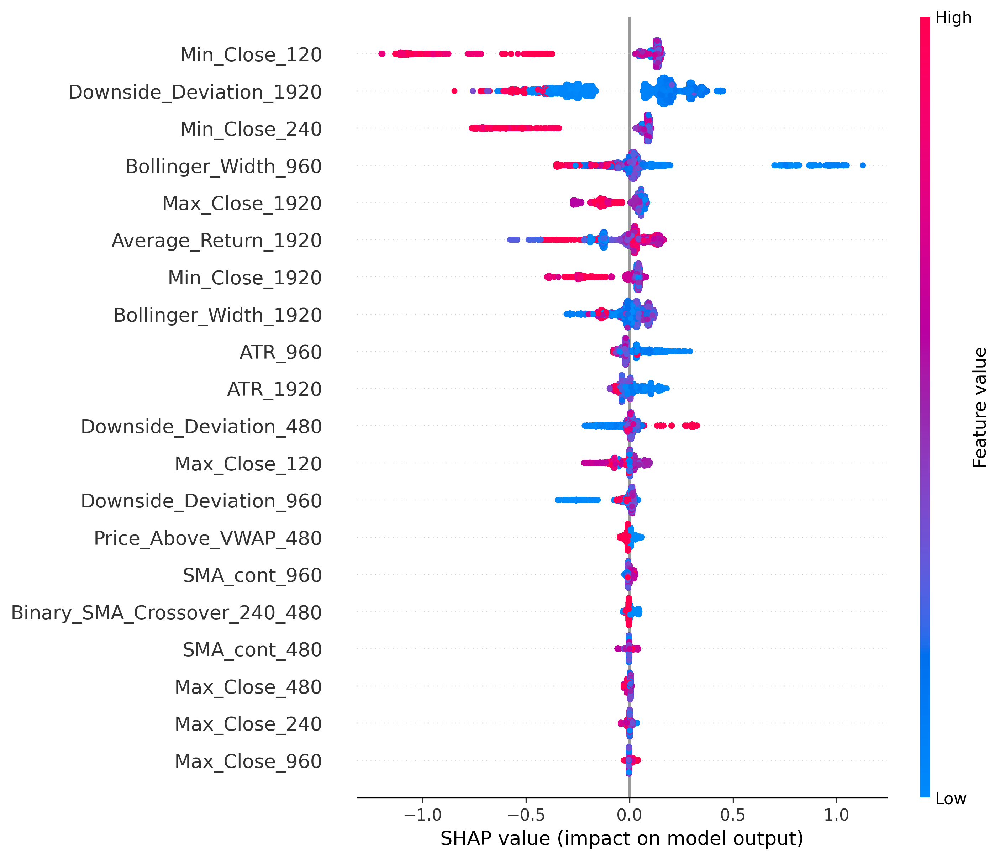

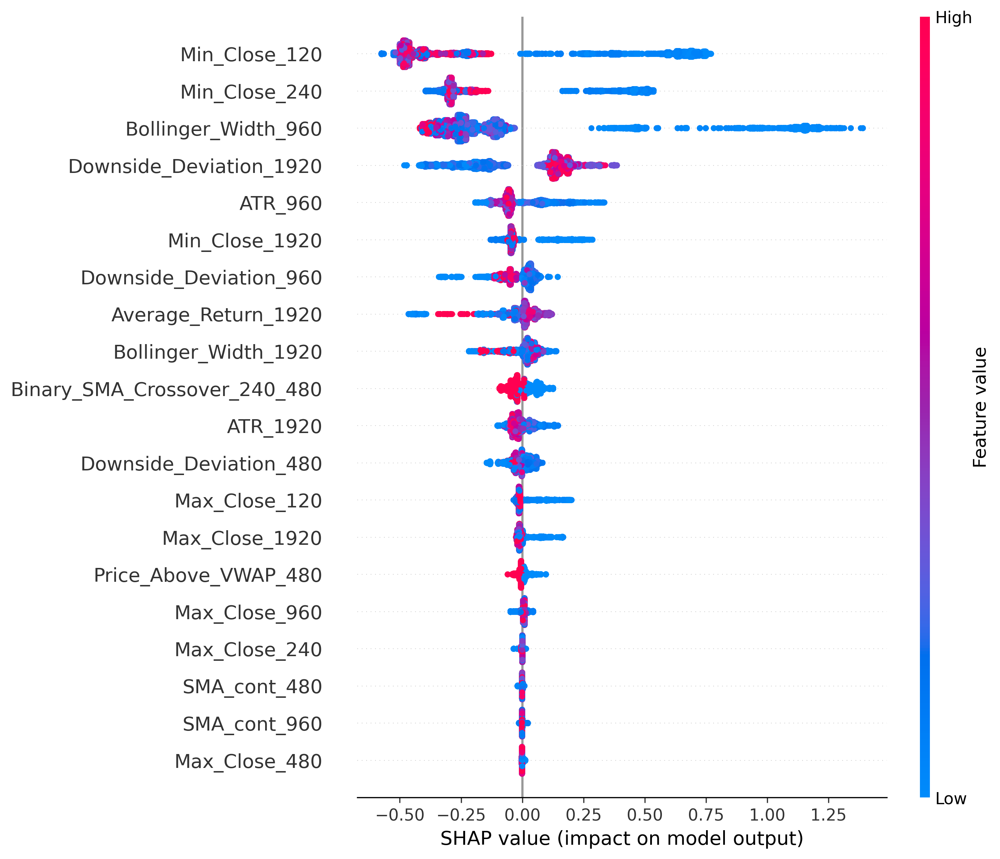

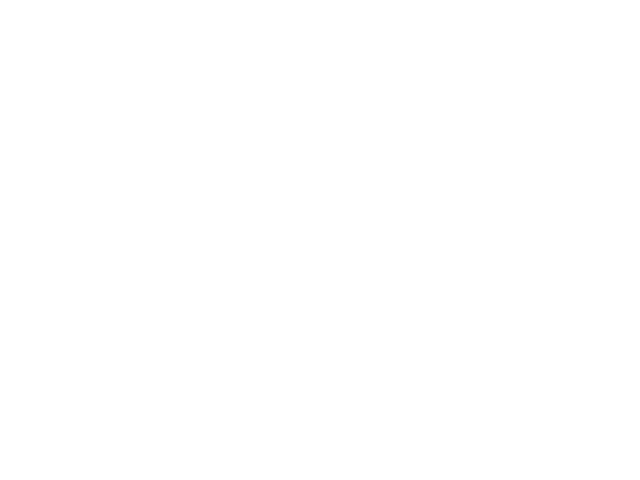

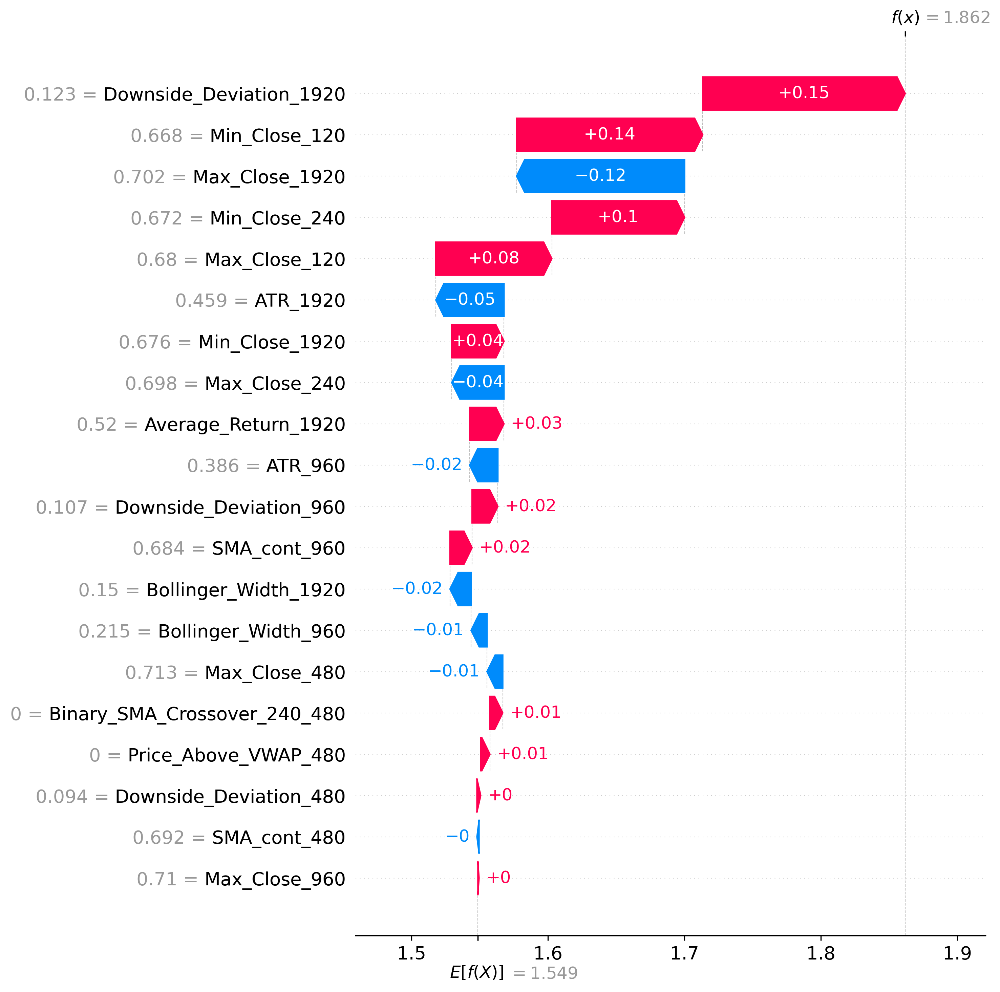

==================================================META==================================================


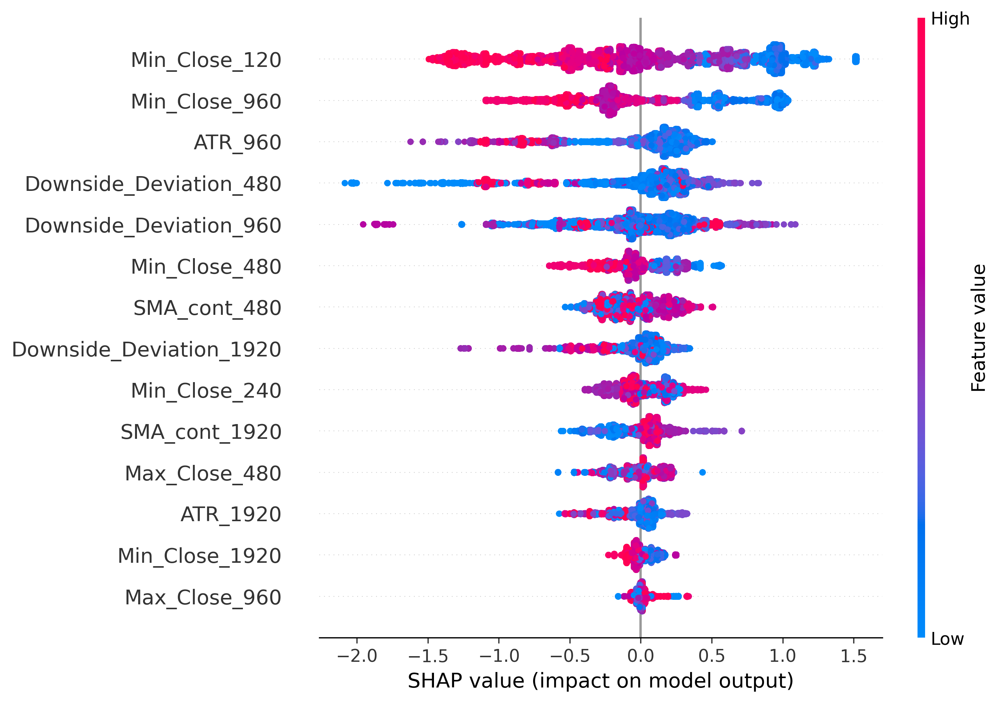

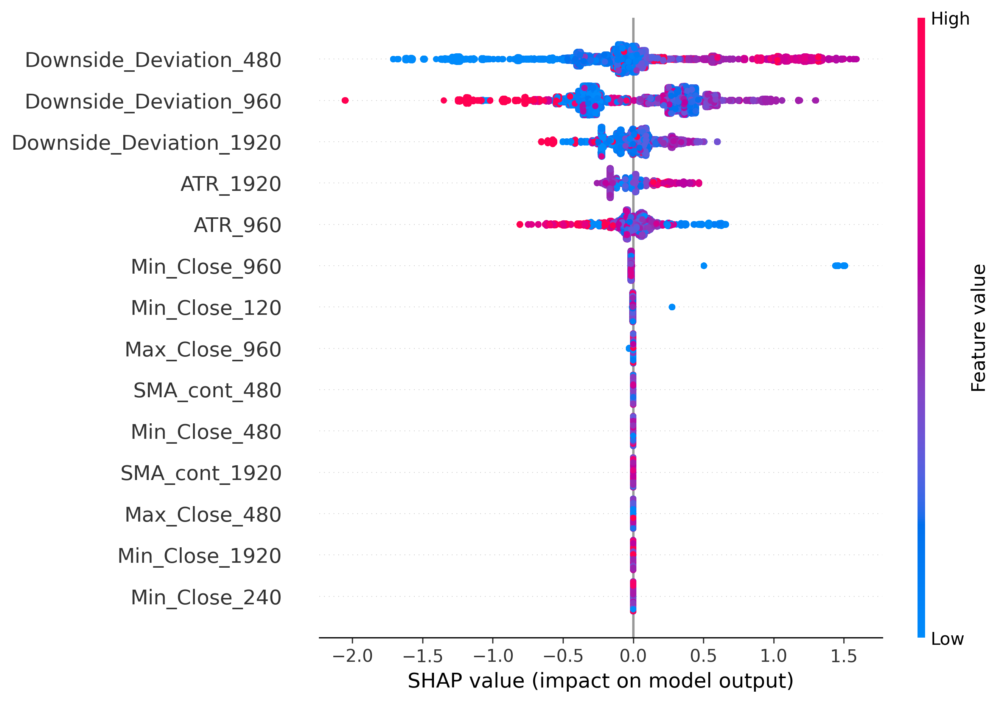

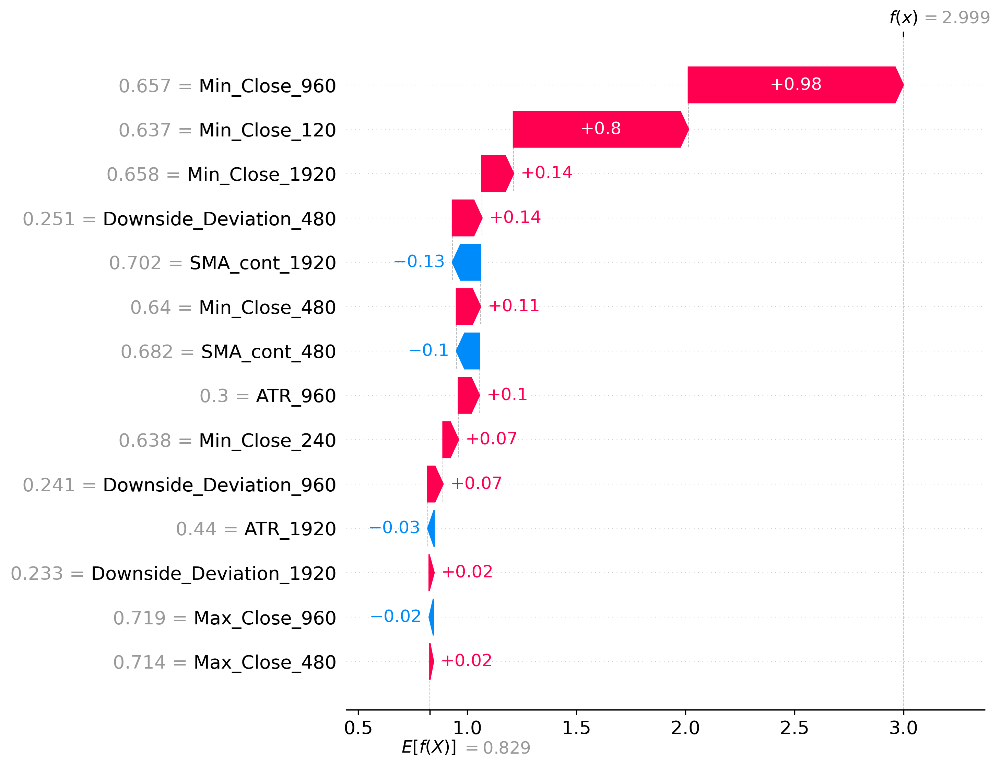

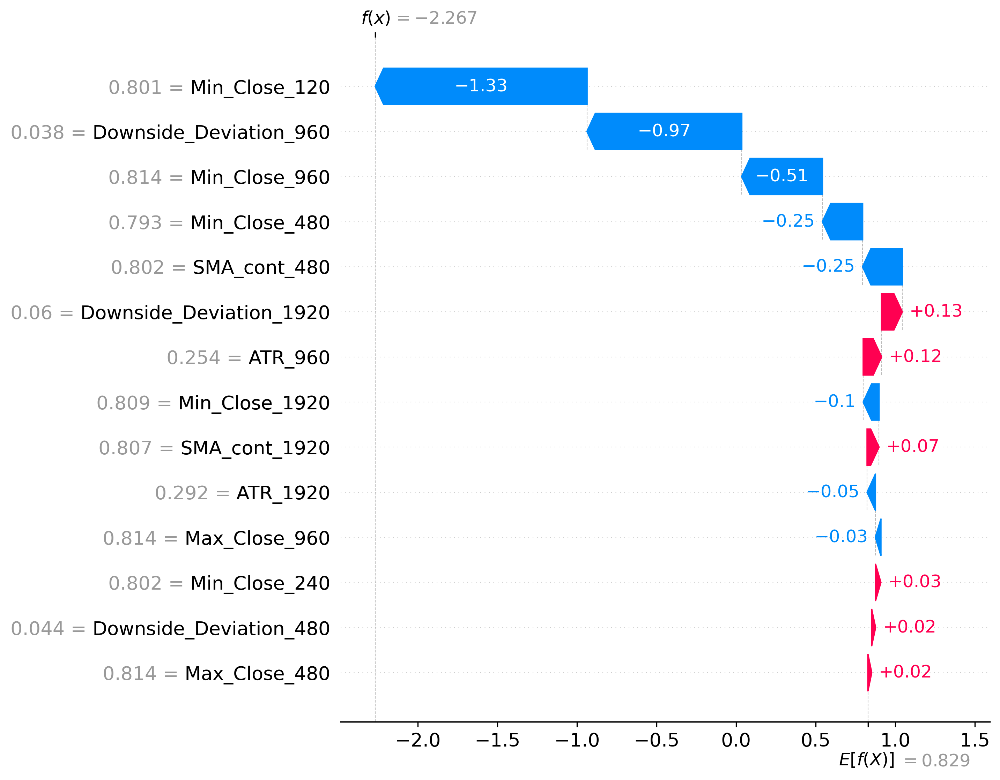

==================================================MSFT==================================================


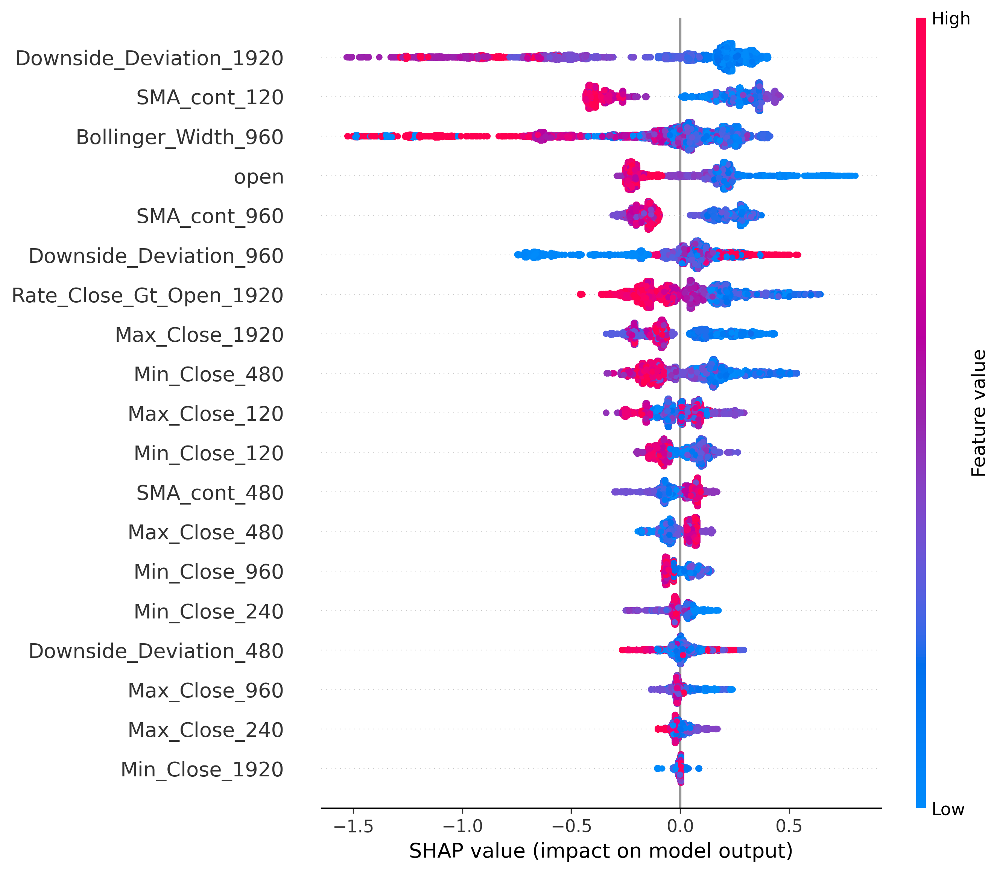

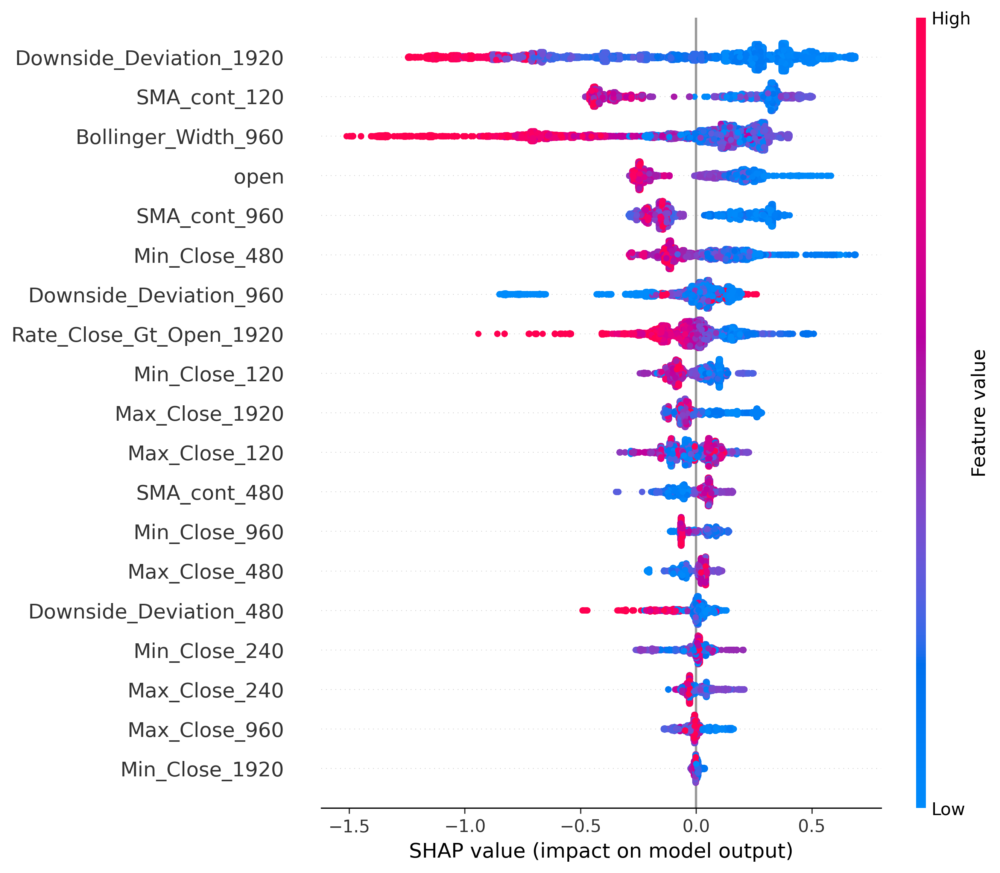

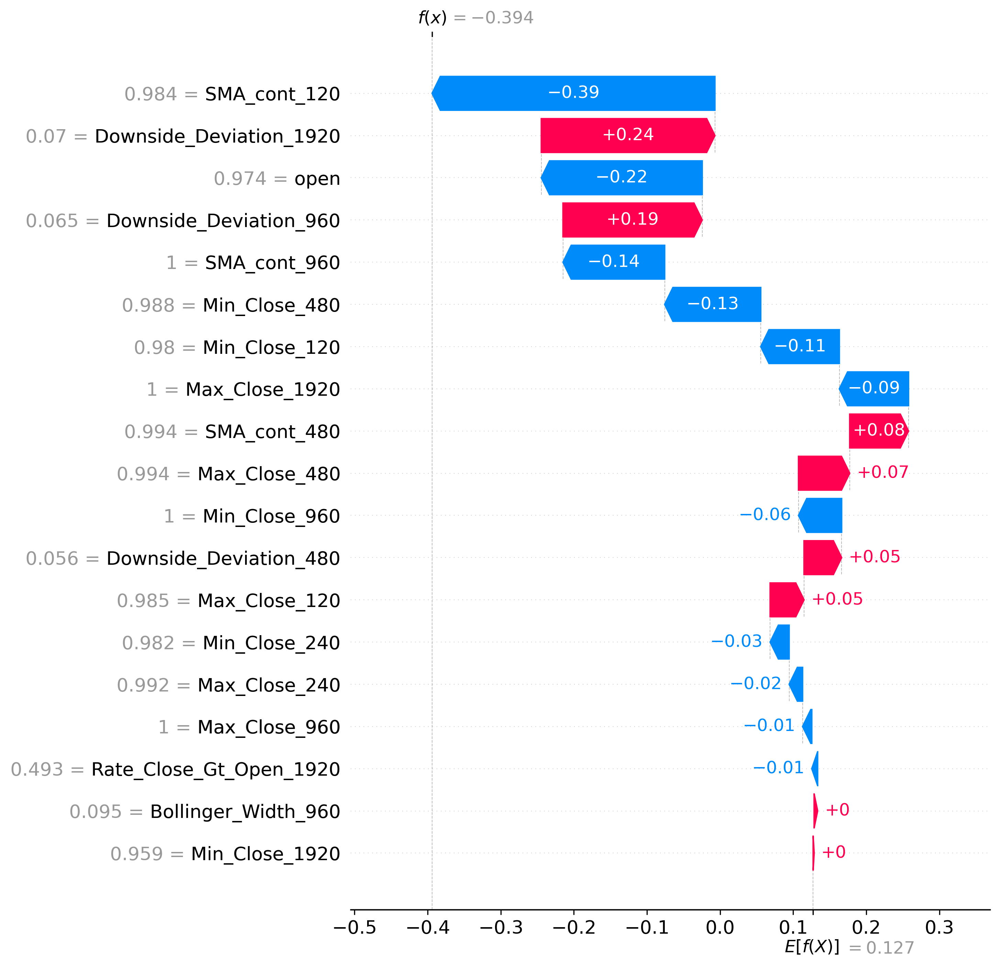

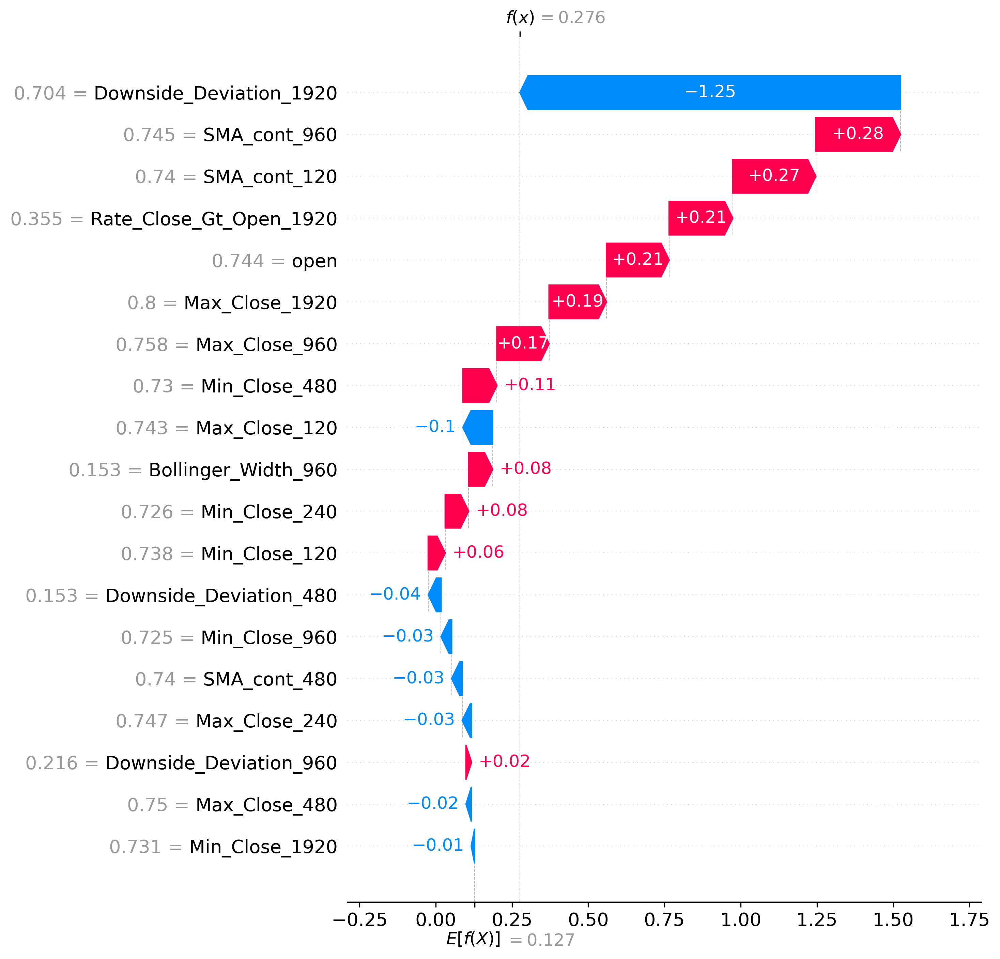

==================================================NFLX==================================================


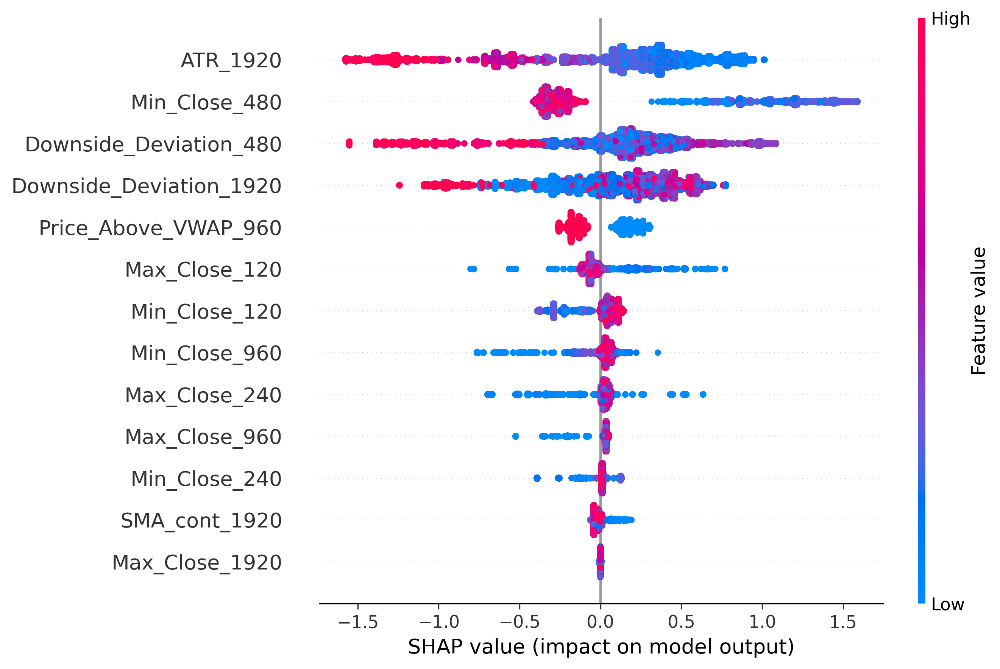

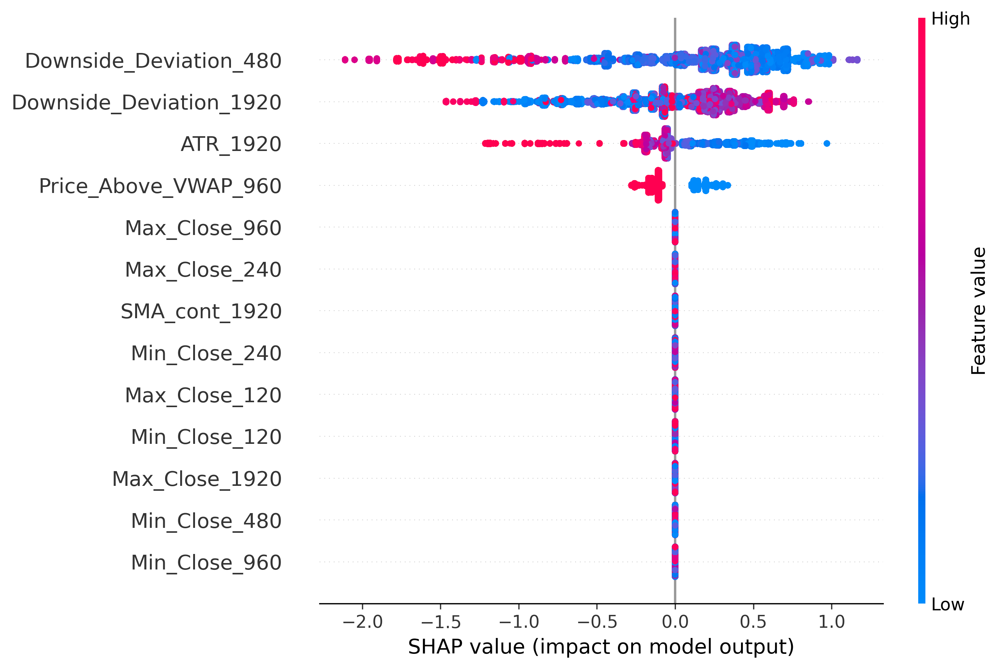

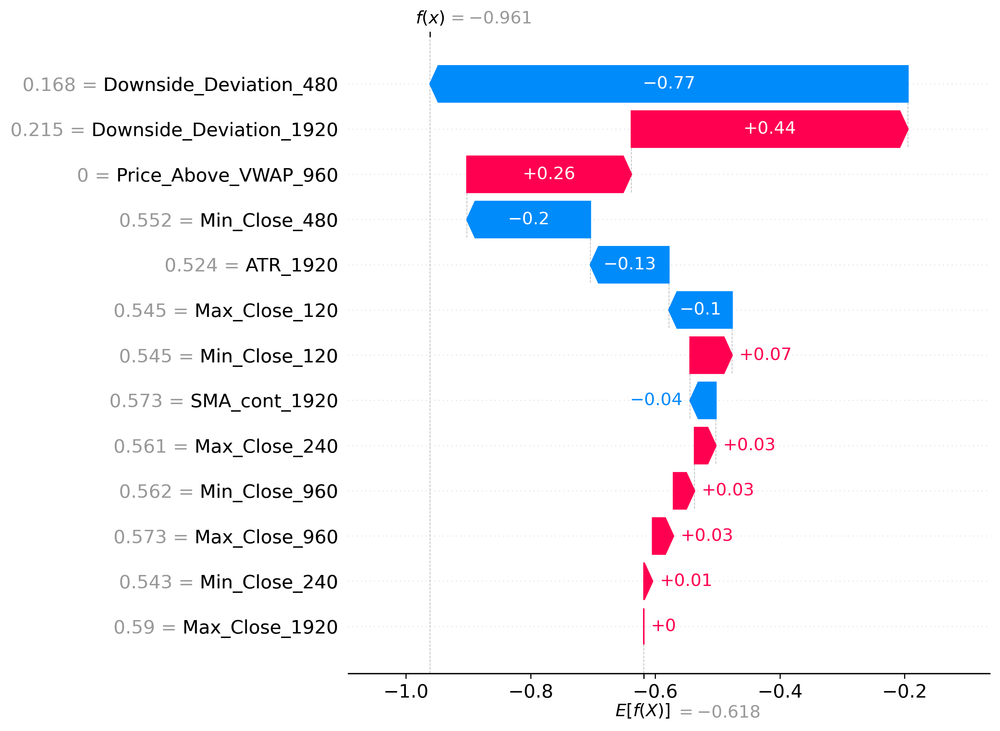

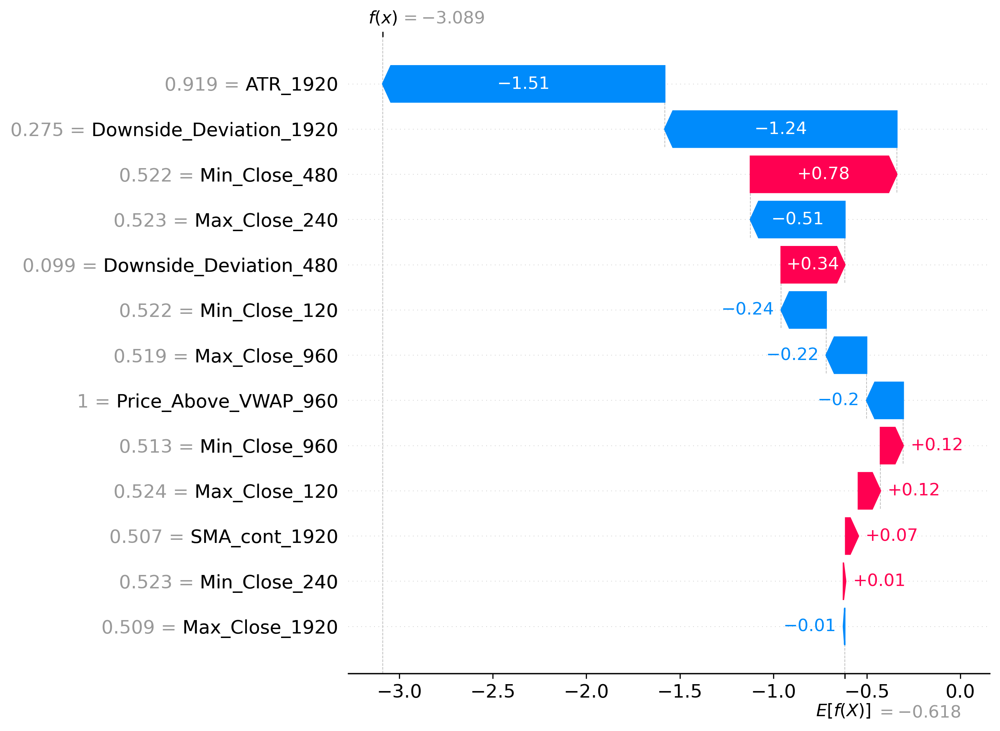

==================================================NKE==================================================


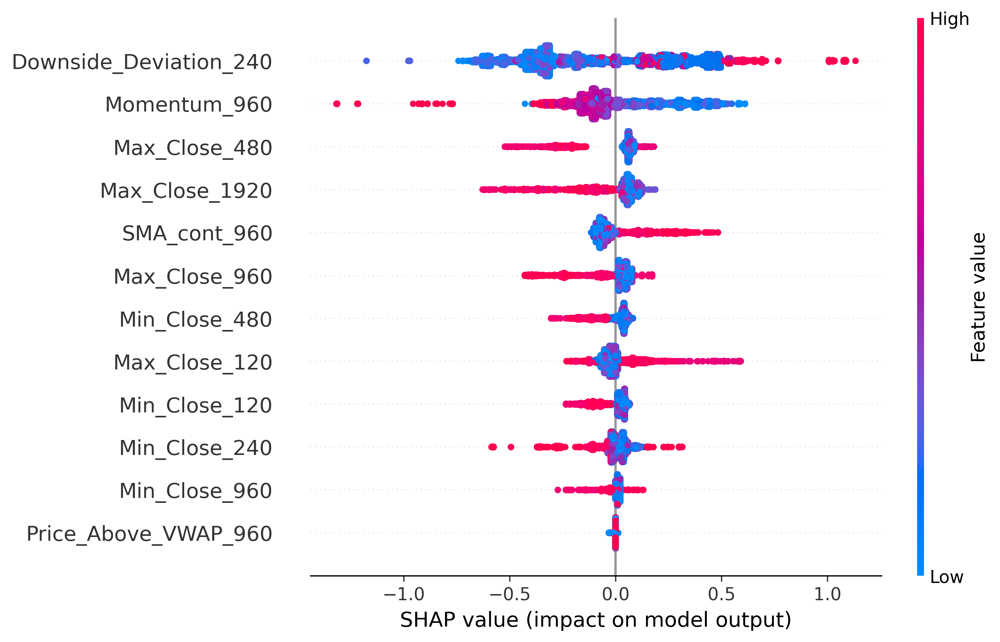

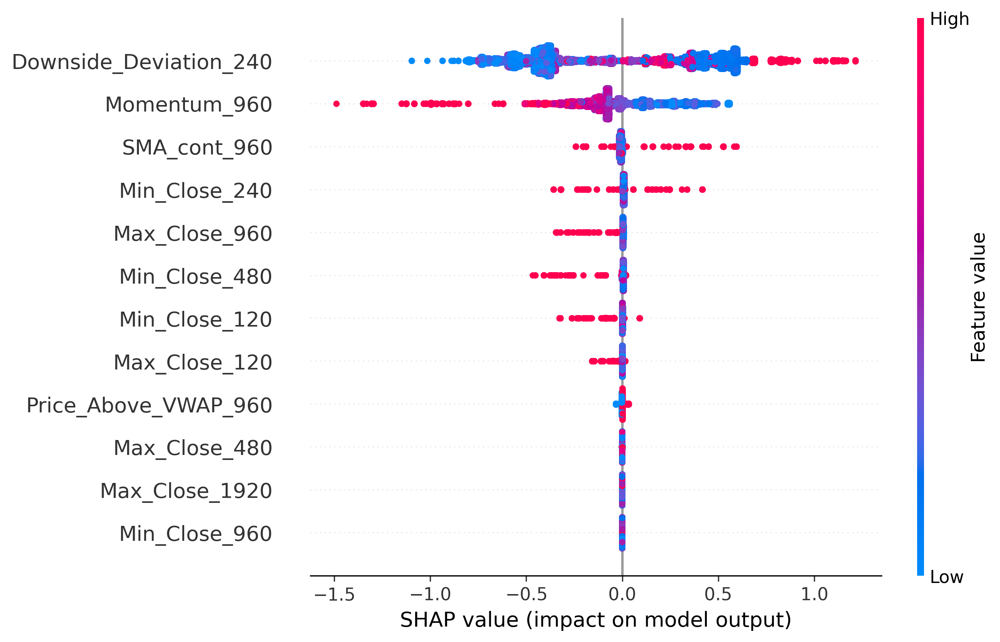

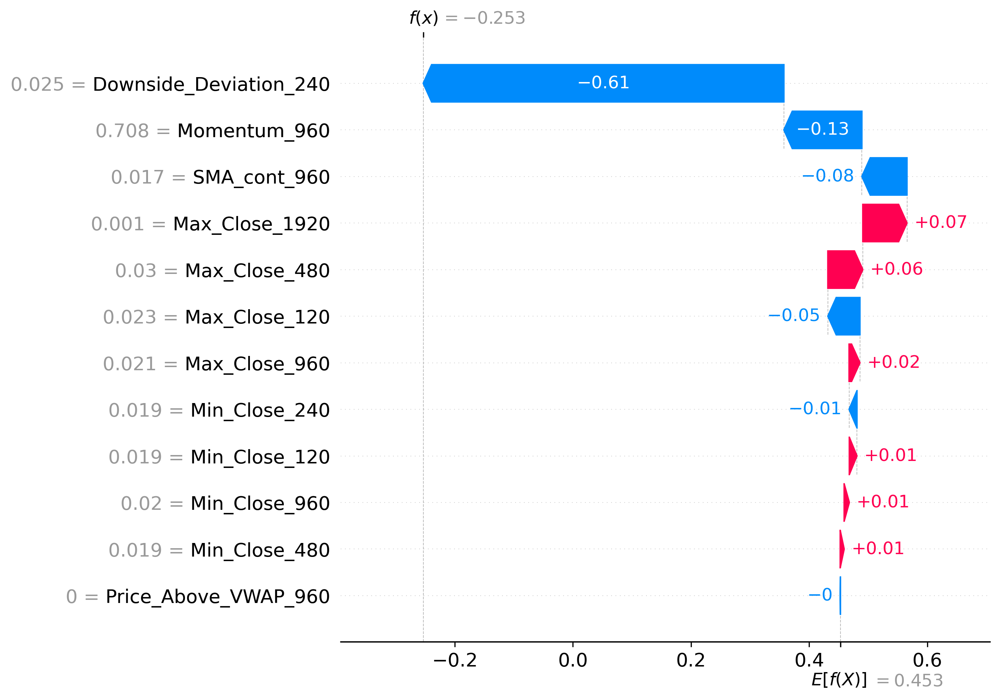

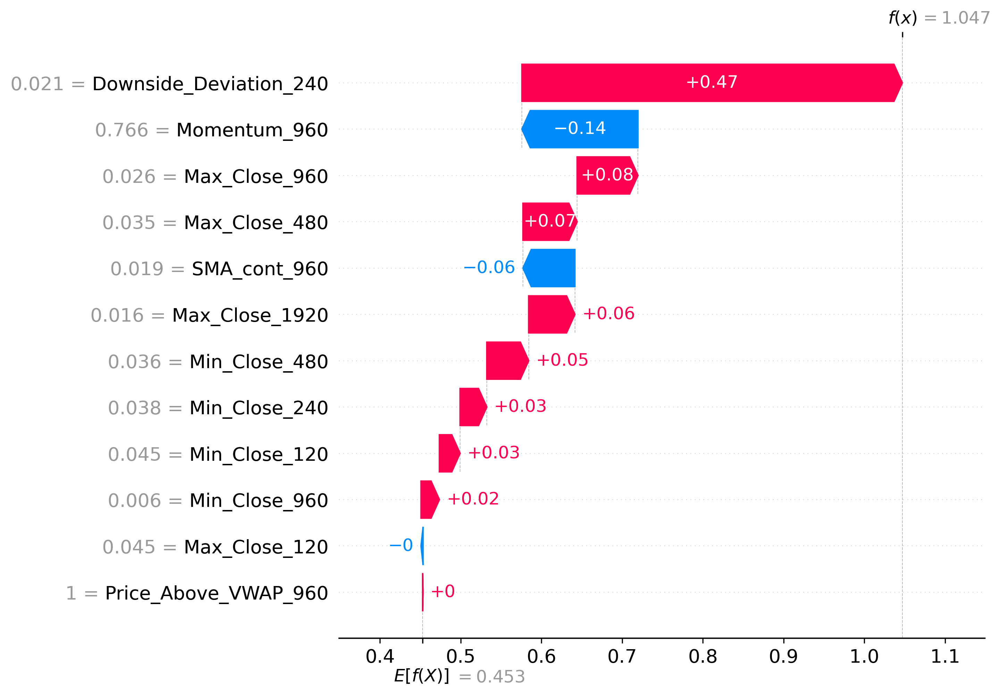

==================================================NVDA==================================================


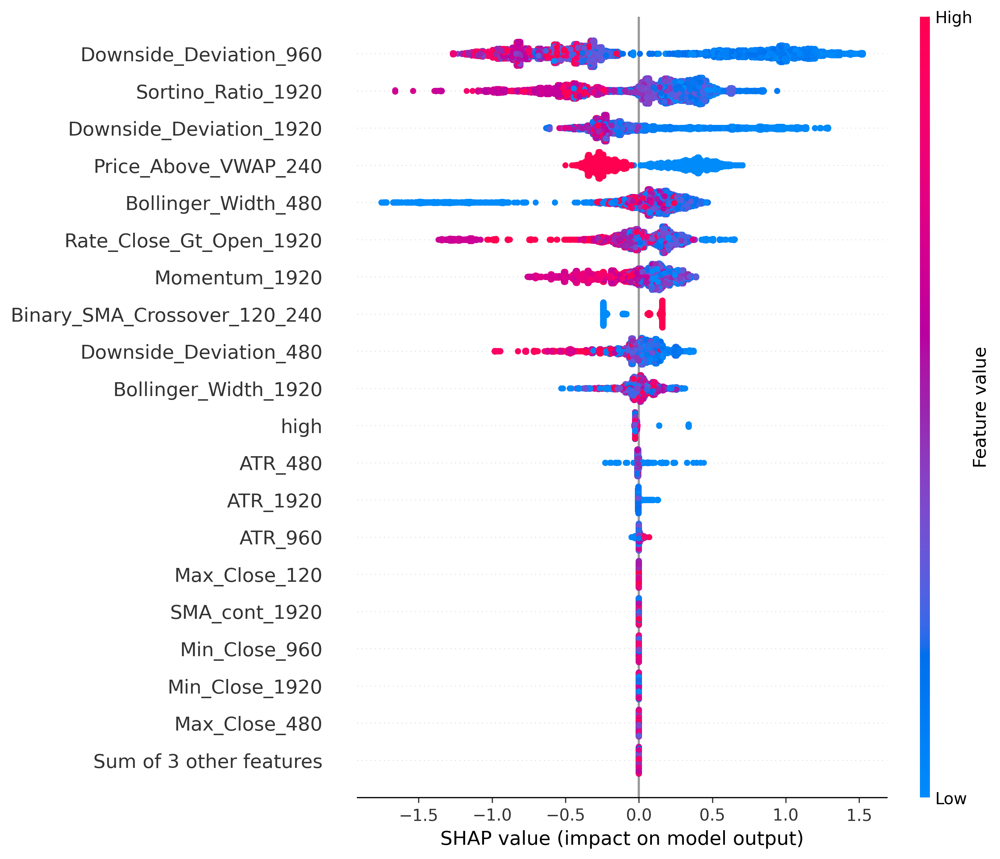

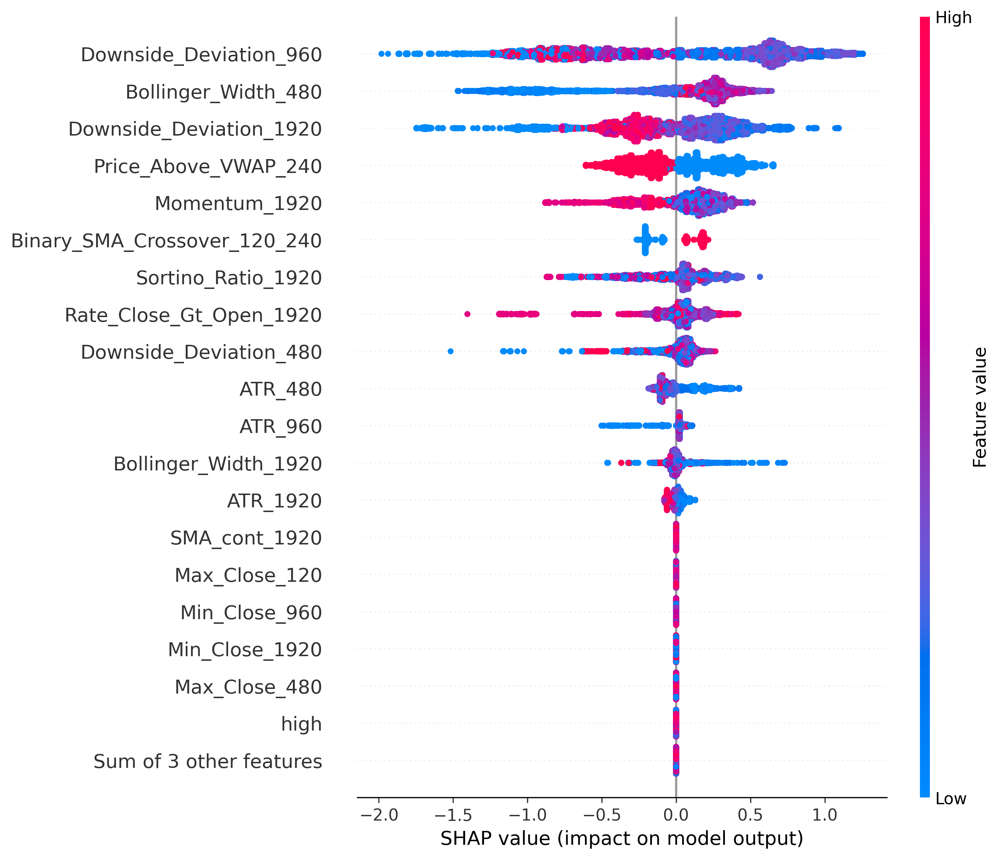

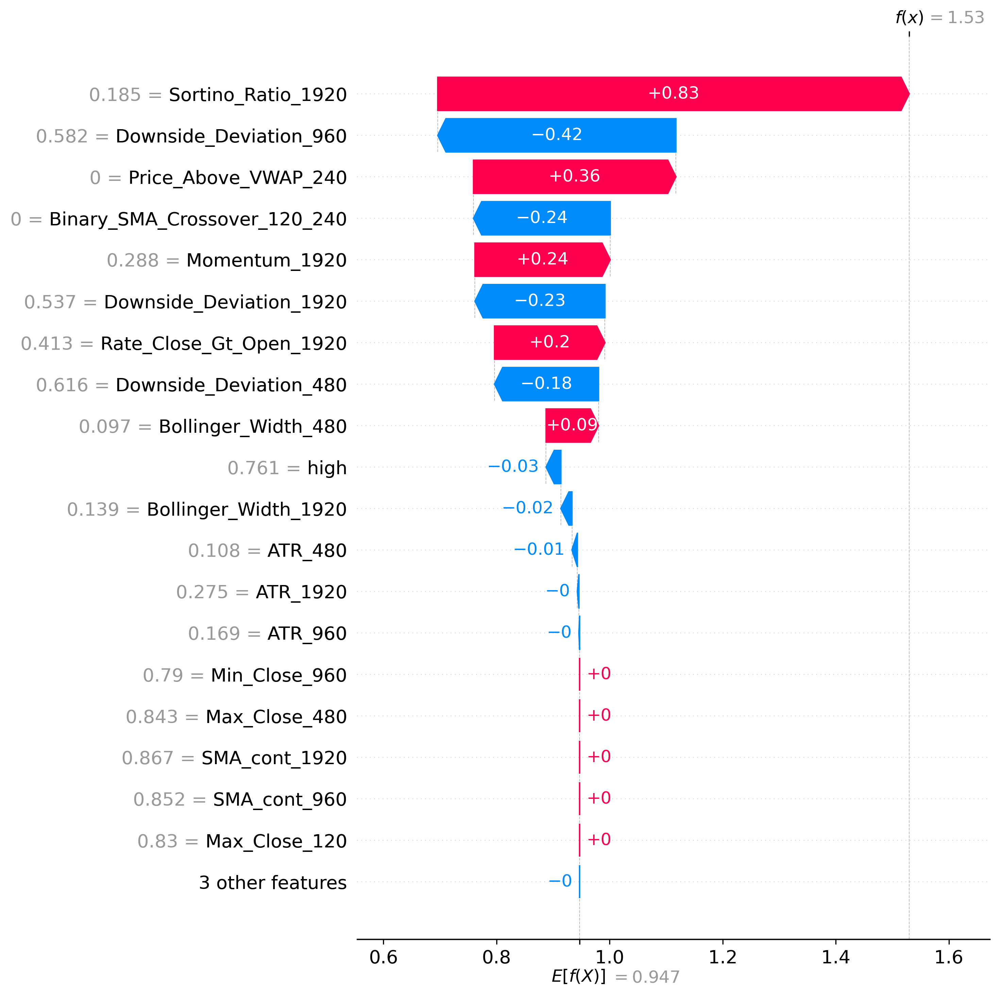

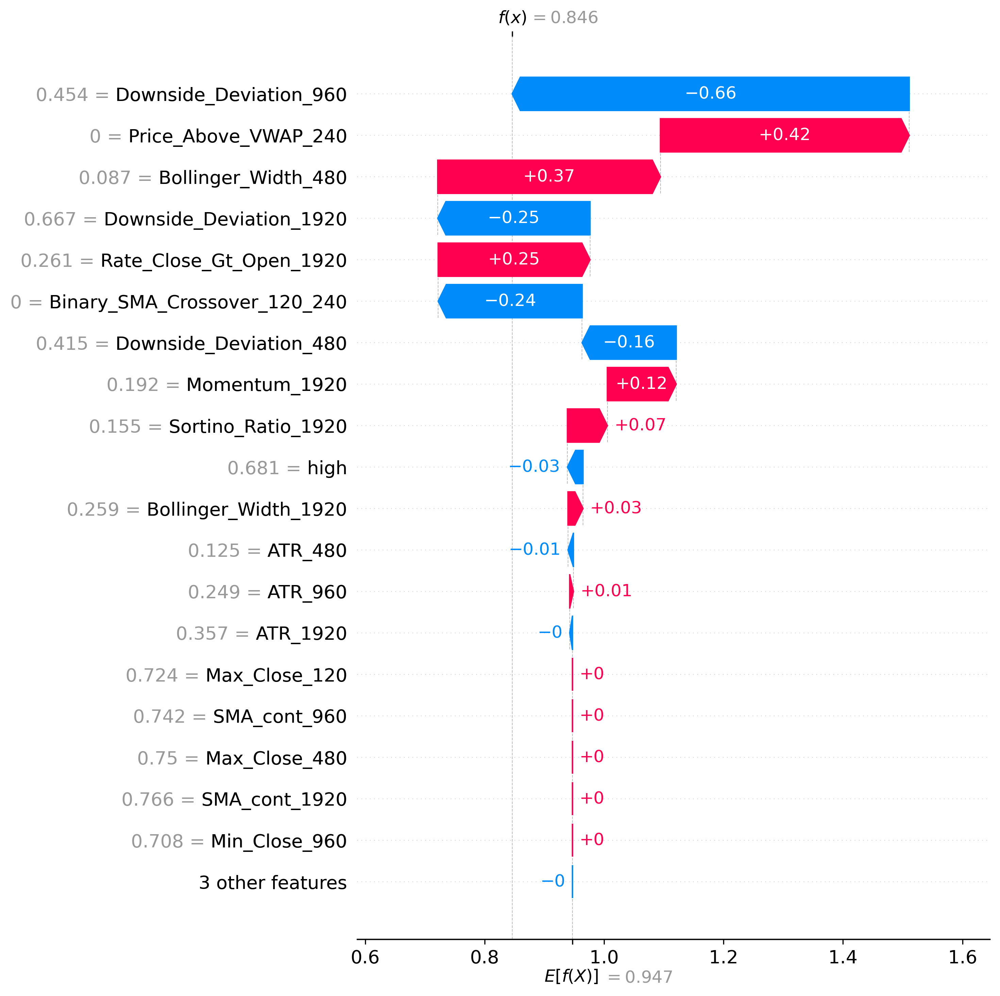

==================================================SPY==================================================


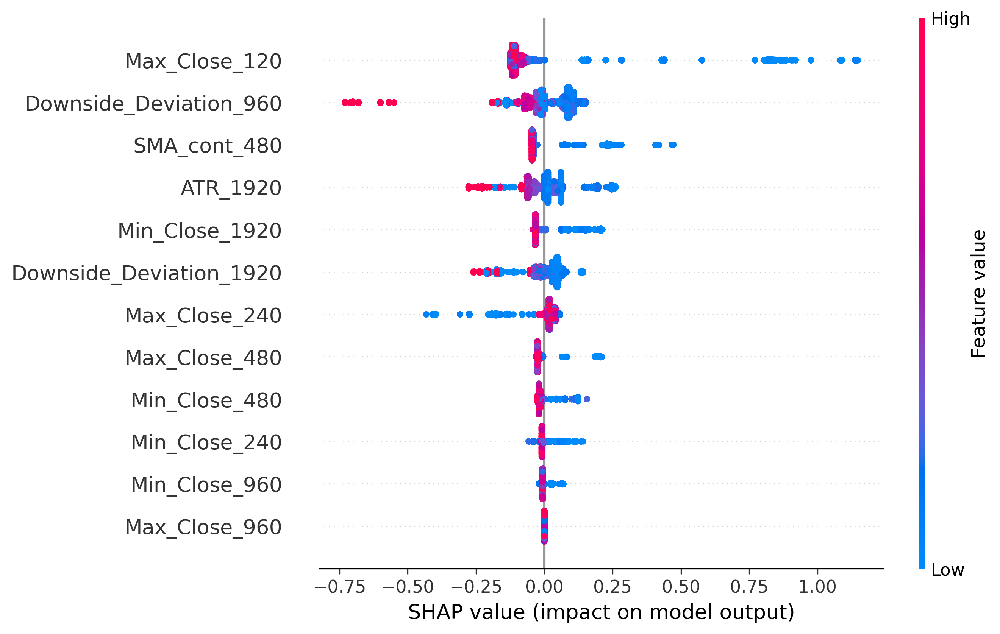

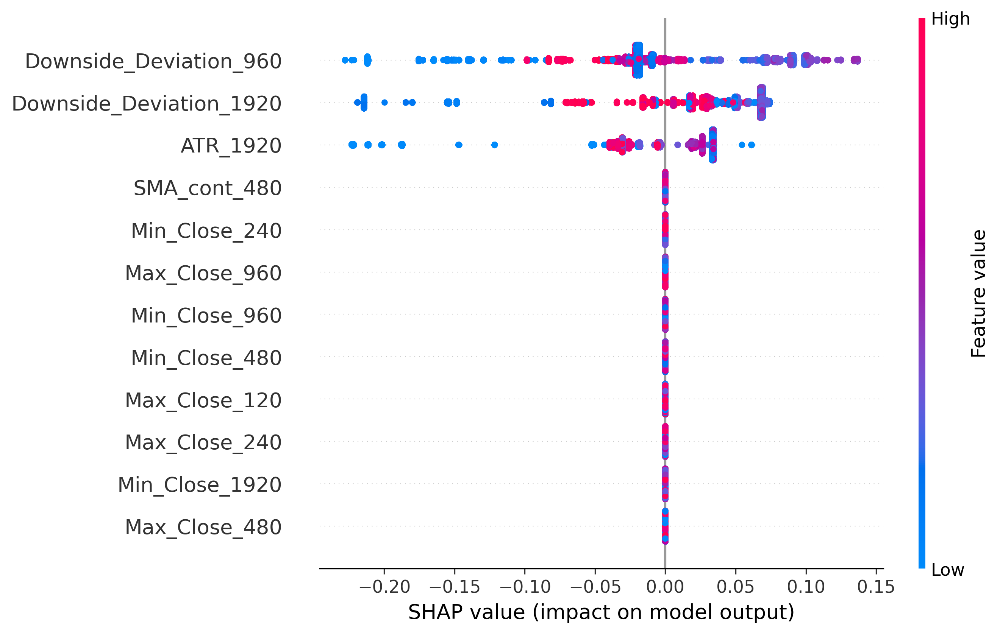

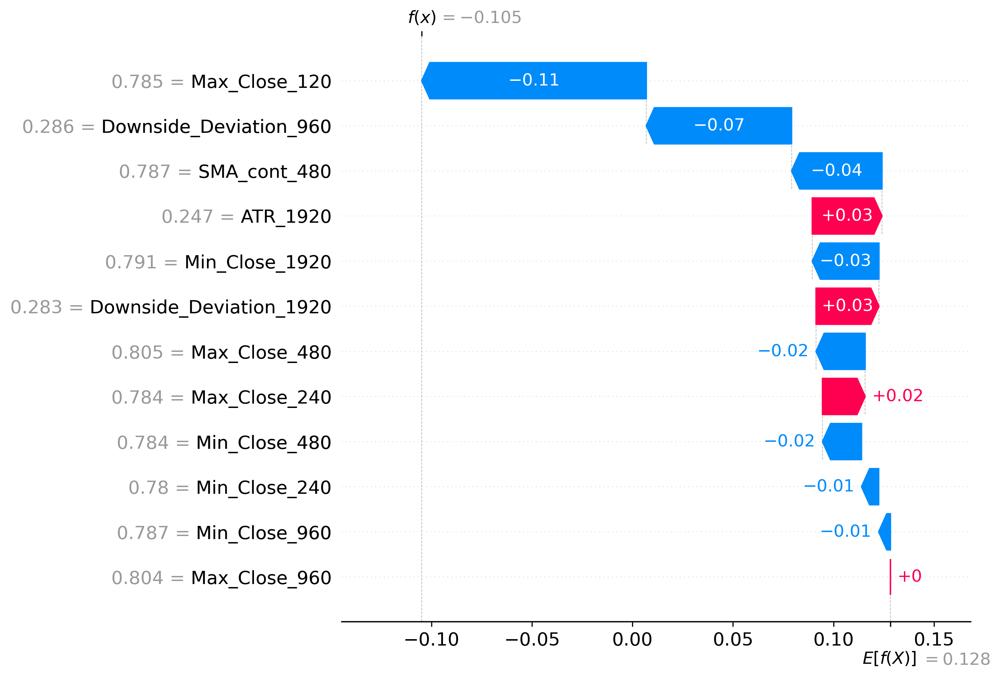

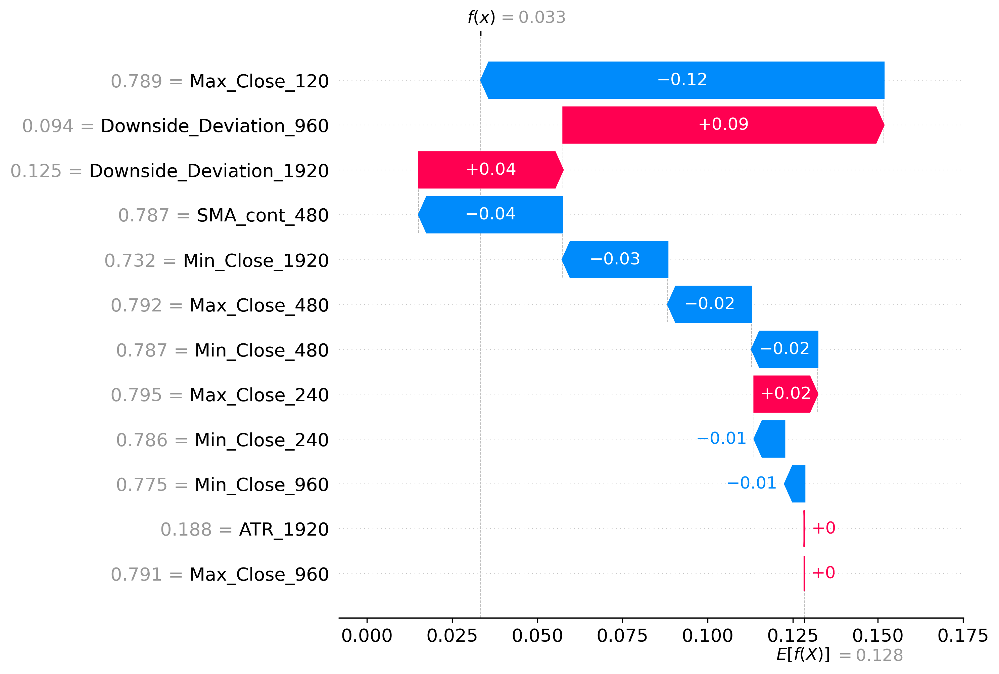

==================================================TSLA==================================================


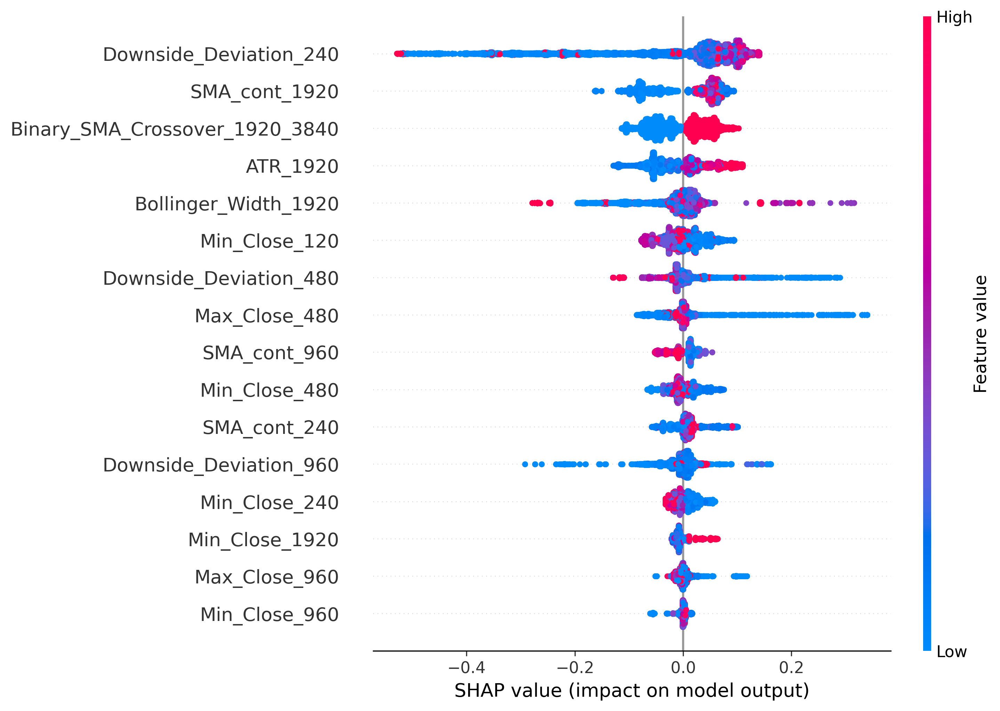

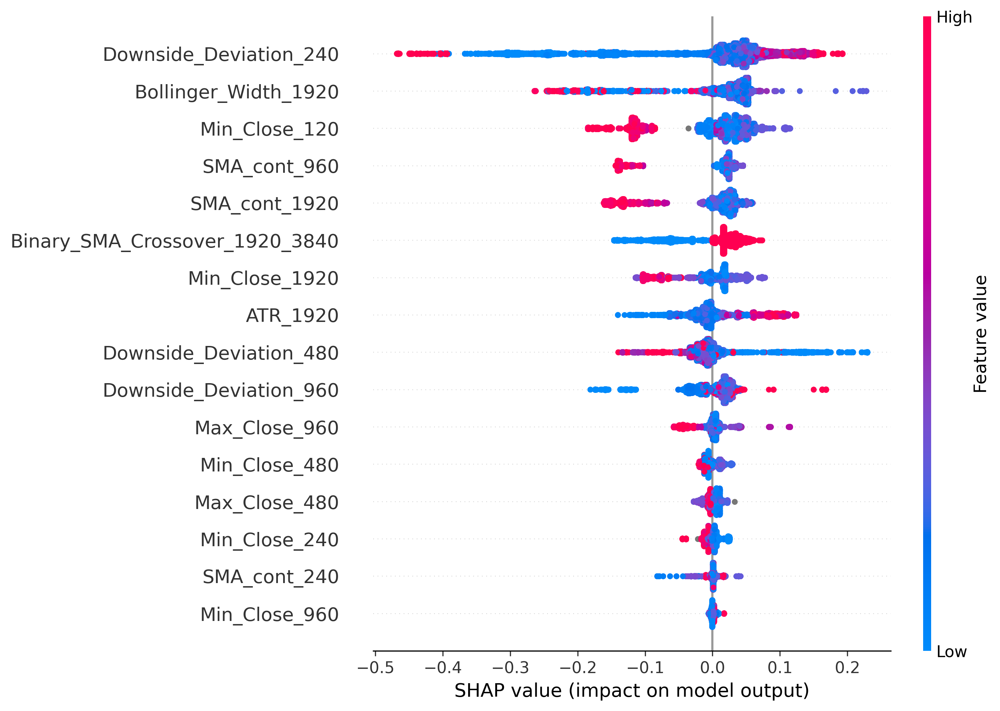

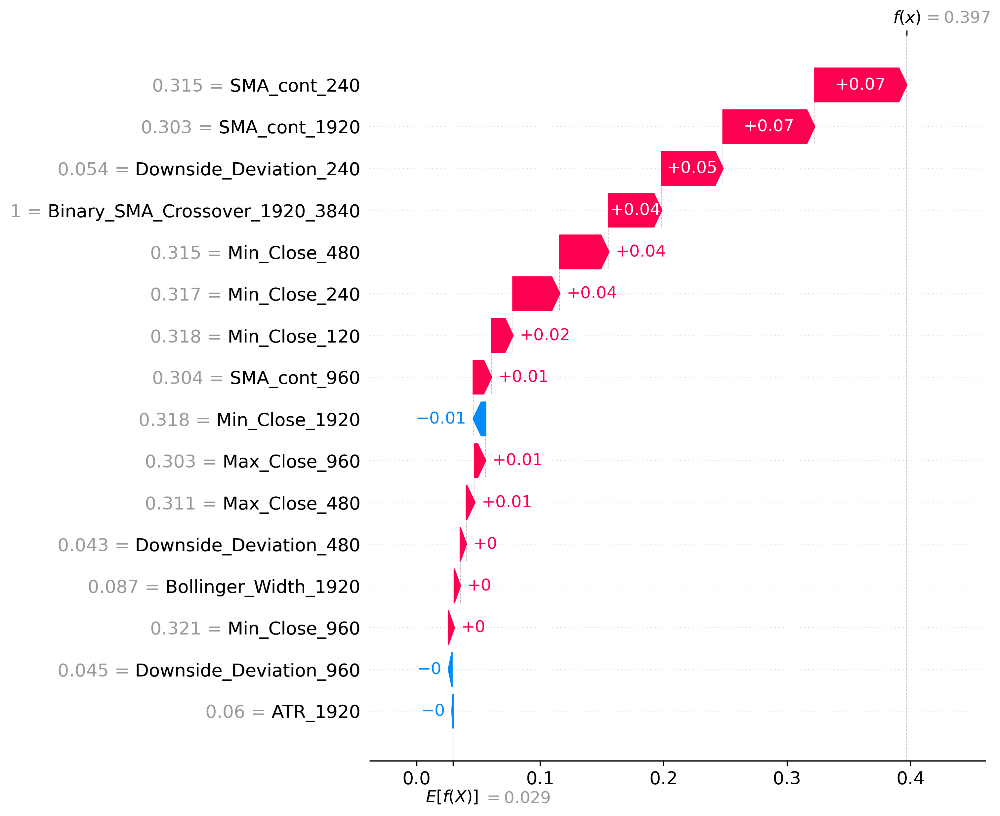

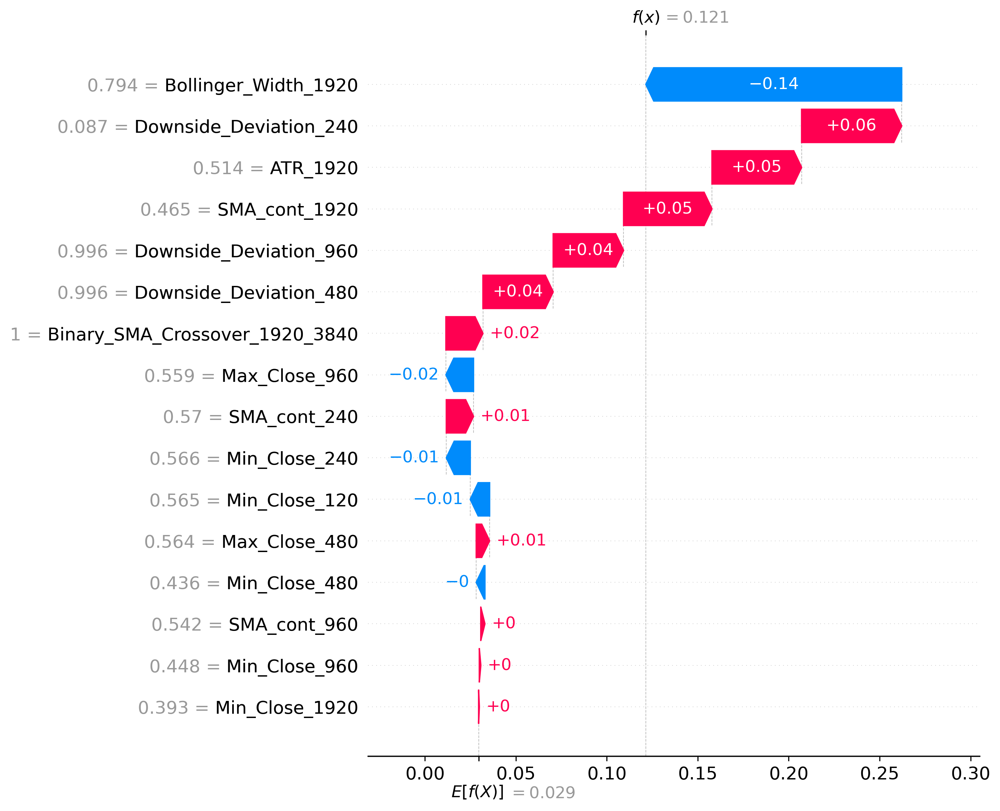

==================================================XOM==================================================


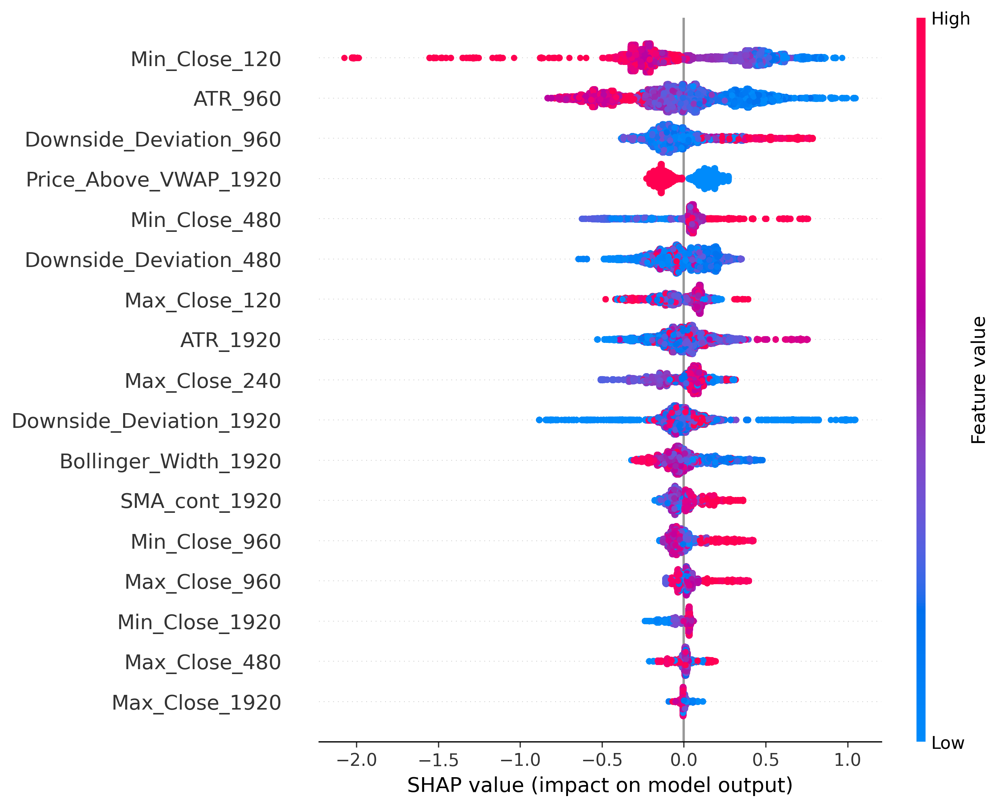

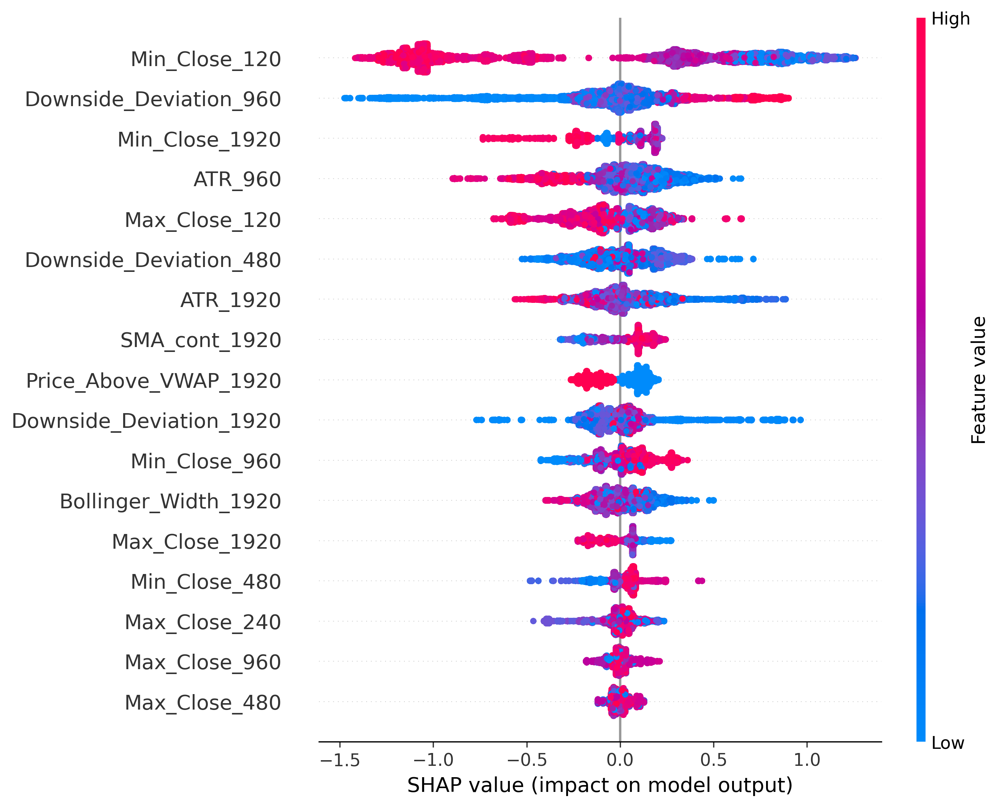

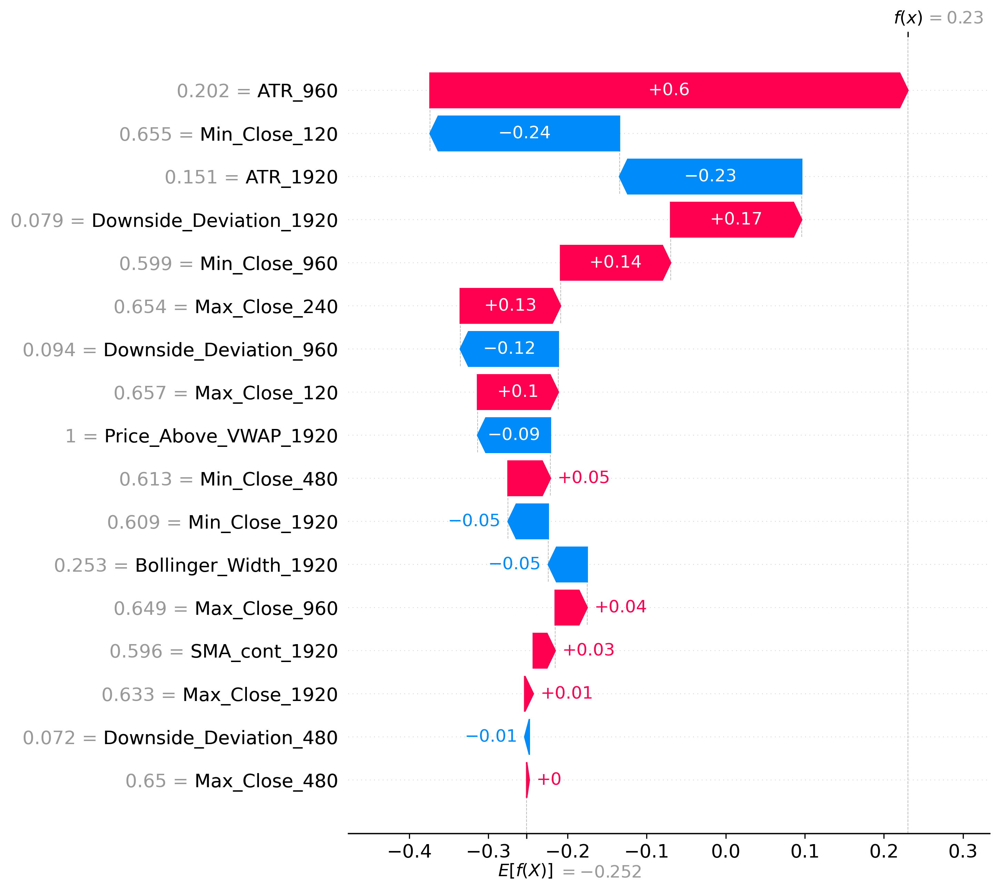

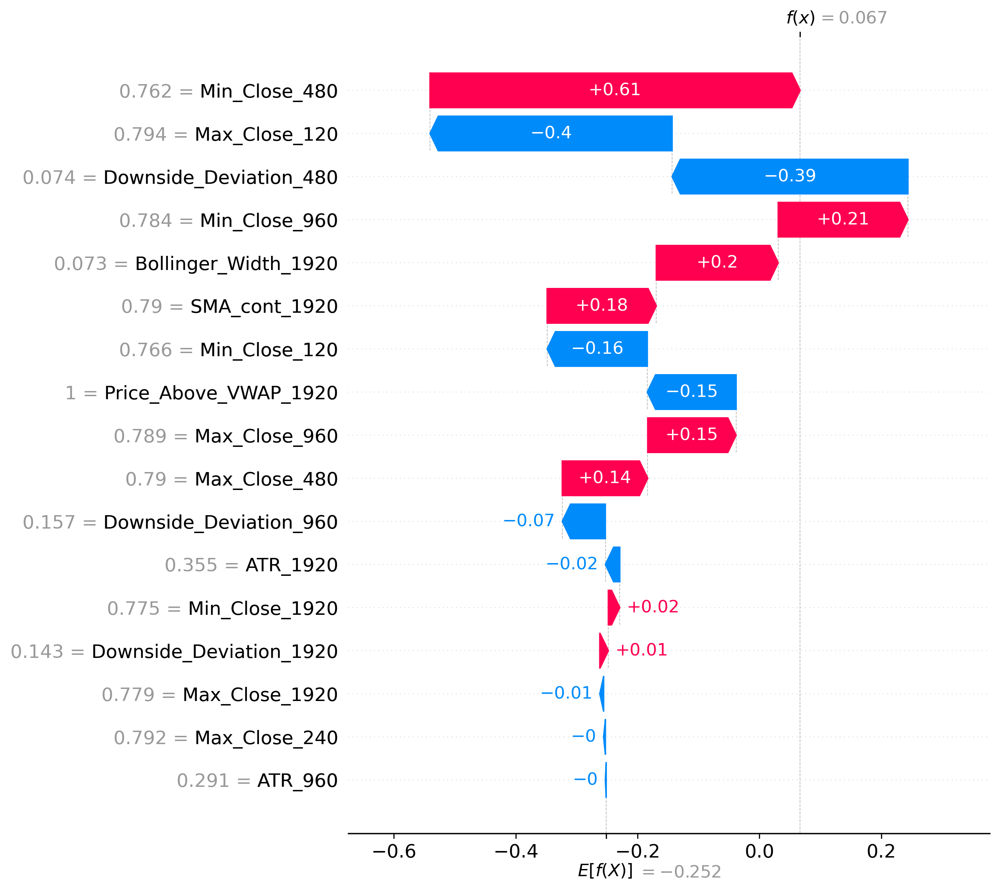

In [3]:
from setup import DataLoader
from steps import FILENAME
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from IPython.display import Image, display

''''''

data_loader = DataLoader(is_google_colab=False)
file_dict = data_loader.get_data_filepath_dict()
print(f'Total Number of Stocks & ETF: {len(file_dict.keys())}')
print(f'Stocks: {[i for i in list(file_dict.keys()) if i != "SPY"]}')
print(f'ETF: {[i for i in list(file_dict.keys()) if i == "SPY"]}')

algo_trading_bot_performance_colnames = ['total_return_percentage', 'win_rate_percentage', 'num_trades', 'sharpe_ratio', 'holding_period']

for stock_ticker in file_dict:
    # stock_ticker = 'AAPL'
    print(f'{"=" * 50}{stock_ticker}{"=" * 50}')
    # print(stock_ticker)
    stock_dir = os.path.join(data_loader.intermediate_data_dir, stock_ticker)
    fp_list = [os.path.join(stock_dir, i) for i in os.listdir(stock_dir) if i.startswith('SHAP_BEESWARM')]
    fpw_list = [os.path.join(stock_dir, i) for i in os.listdir(stock_dir) if i.startswith('SHAP_WATERFALL')]
    # display(Image(fp))
    for i in fp_list:
        display(Image(i))
    for i in fpw_list[:2]:
        display(Image(i))

    

In [5]:
from setup import DataLoader
from steps import FILENAME
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from IPython.display import Image, display

''''''

data_loader = DataLoader(is_google_colab=False)
file_dict = data_loader.get_data_filepath_dict()
print(f'Total Number of Stocks & ETF: {len(file_dict.keys())}')
print(f'Stocks: {[i for i in list(file_dict.keys()) if i != "SPY"]}')
print(f'ETF: {[i for i in list(file_dict.keys()) if i == "SPY"]}')

algo_trading_bot_performance_colnames = ['total_return_percentage', 'win_rate_percentage', 'num_trades', 'sharpe_ratio', 'holding_period']

for stock_ticker in file_dict:
    # stock_ticker = 'AAPL'
    print(f'{"=" * 50}{stock_ticker}{"=" * 50}')
    # print(stock_ticker)
    stock_dir = os.path.join(data_loader.intermediate_data_dir, stock_ticker)
    startegy_data_test_1 = os.path.join(stock_dir, FILENAME.STRATEGY_RESULT_TEST_1)
    startegy_data_test_1_df = pd.read_csv(startegy_data_test_1)
    print(startegy_data_test_1_df)

Total Number of Stocks & ETF: 11
Stocks: ['AAPL', 'AMD', 'AMZN', 'META', 'MSFT', 'NFLX', 'NKE', 'NVDA', 'TSLA', 'XOM']
ETF: ['SPY']
==================================================AAPL==================================================
    Unnamed: 0  holding_period  take_profit  stop_loss  threshold  num_trades  \
0            0              60        0.005     -0.005        0.5         248   
1            1              60        0.005     -0.005        0.6         131   
2            2              60        0.005     -0.005        0.7         100   
3            3              60        0.005     -0.005        0.8          50   
4            4              60        0.005     -0.005        0.9           0   
5            5              60        0.005     -0.010        0.5         170   
6            6              60        0.005     -0.010        0.6          94   
7            7              60        0.005     -0.010        0.7          72   
8            8              60    

    Unnamed: 0  holding_period  take_profit  stop_loss  threshold  num_trades  \
0            0              60        0.005     -0.005        0.5        1062   
1            1              60        0.005     -0.005        0.6        1018   
2            2              60        0.005     -0.005        0.7         888   
3            3              60        0.005     -0.005        0.8         799   
4            4              60        0.005     -0.005        0.9          66   
5            5              60        0.005     -0.010        0.5         748   
6            6              60        0.005     -0.010        0.6         724   
7            7              60        0.005     -0.010        0.7         633   
8            8              60        0.005     -0.010        0.8         568   
9            9              60        0.005     -0.010        0.9          53   
10          10              60        0.010     -0.005        0.5         741   
11          11              

Total Number of Stocks & ETF: 11
Stocks: ['AAPL', 'AMD', 'AMZN', 'META', 'MSFT', 'NFLX', 'NKE', 'NVDA', 'TSLA', 'XOM']
ETF: ['SPY']
==================================================AAPL==================================================


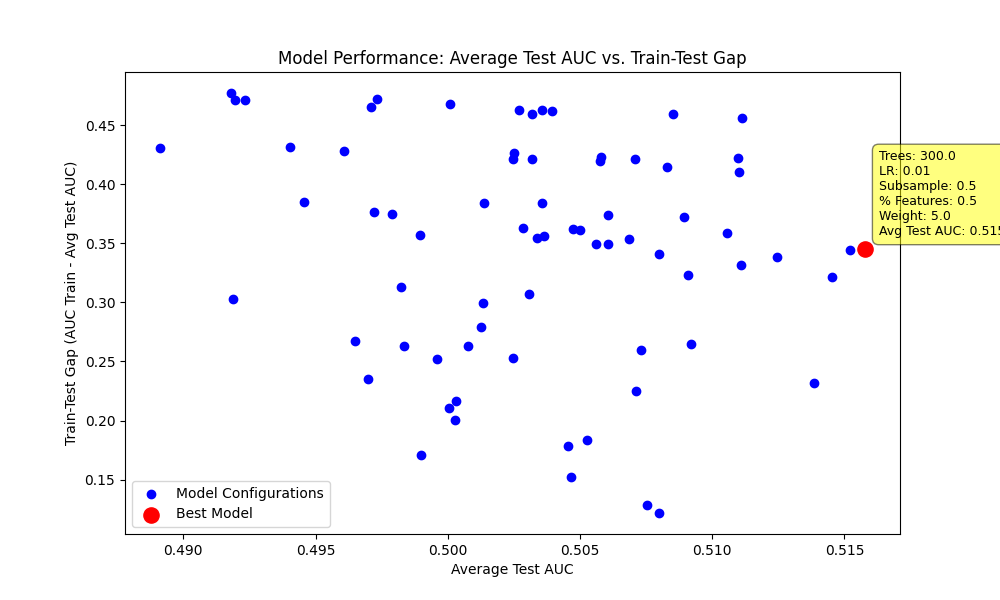

==================================================AMD==================================================


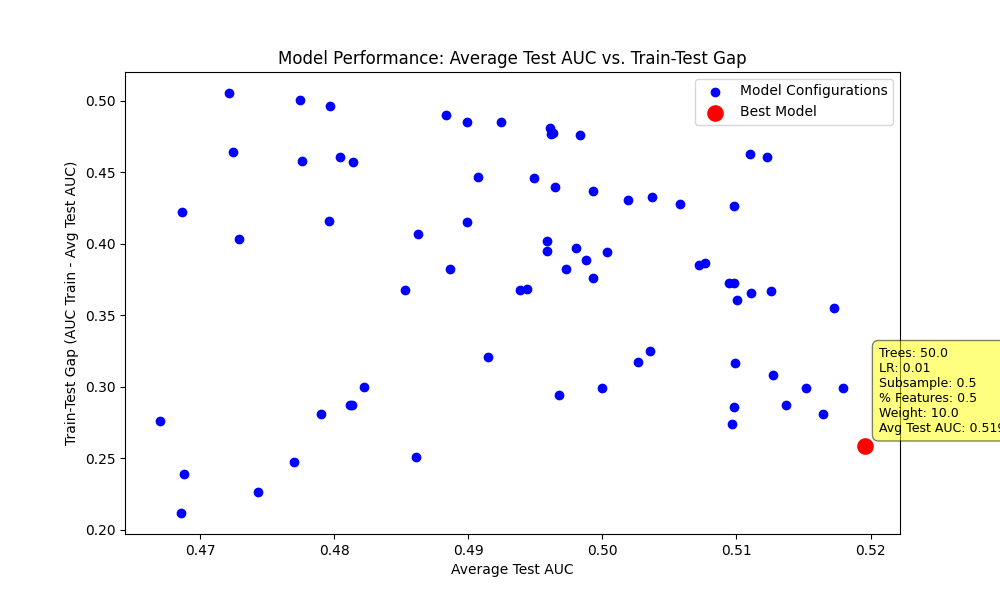

==================================================AMZN==================================================


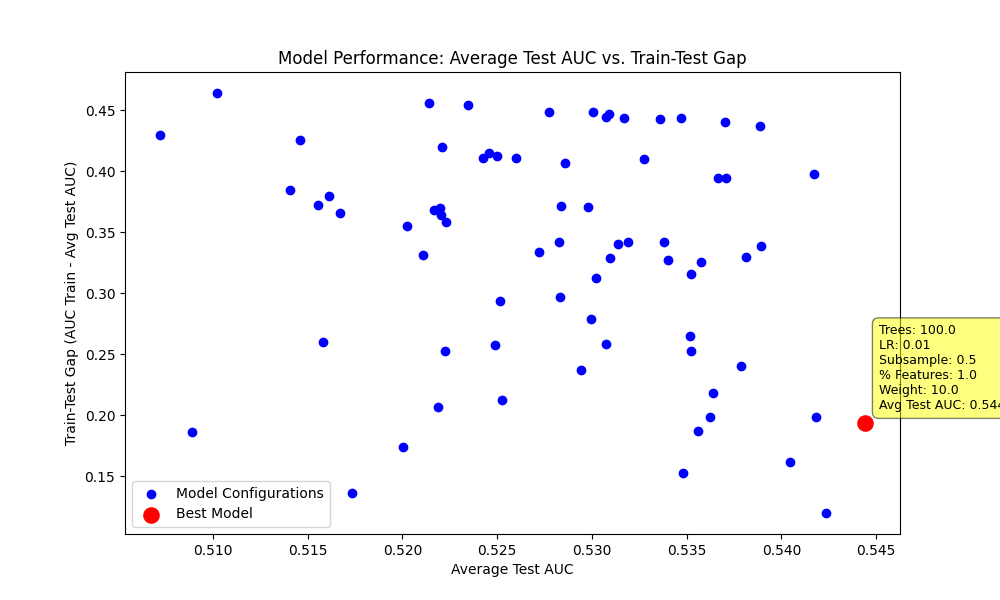

==================================================META==================================================


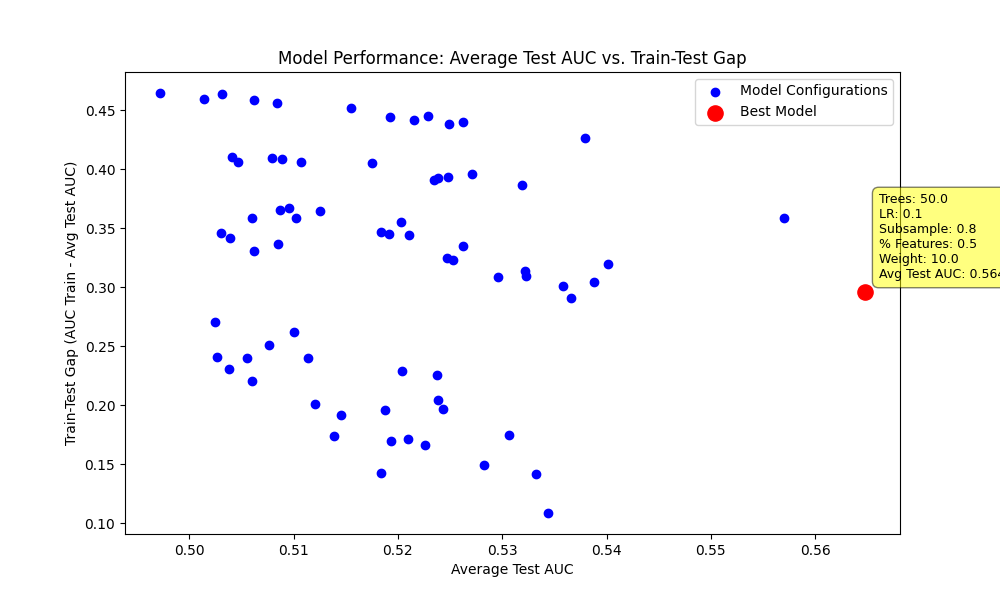

==================================================MSFT==================================================


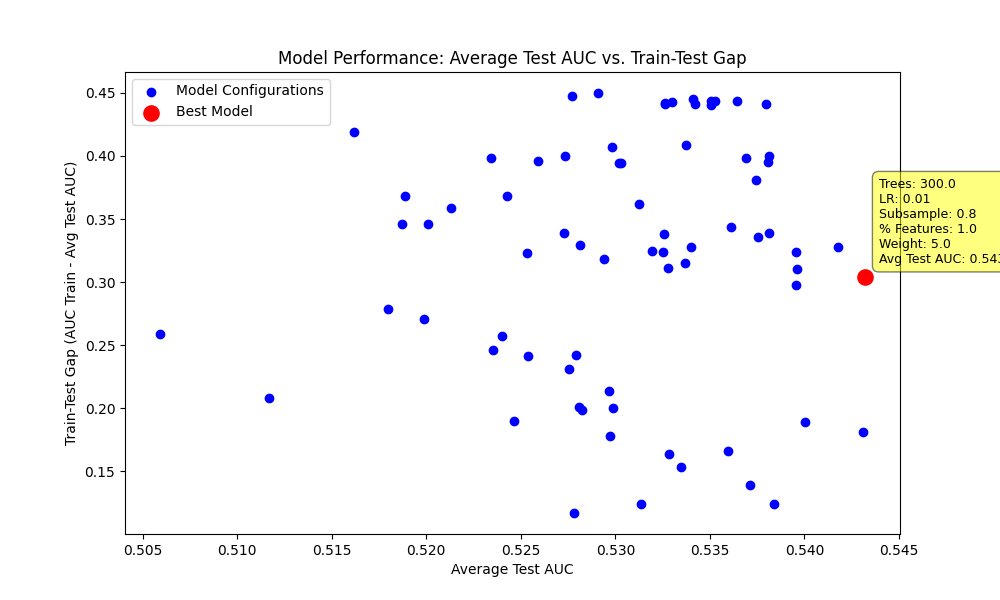

==================================================NFLX==================================================


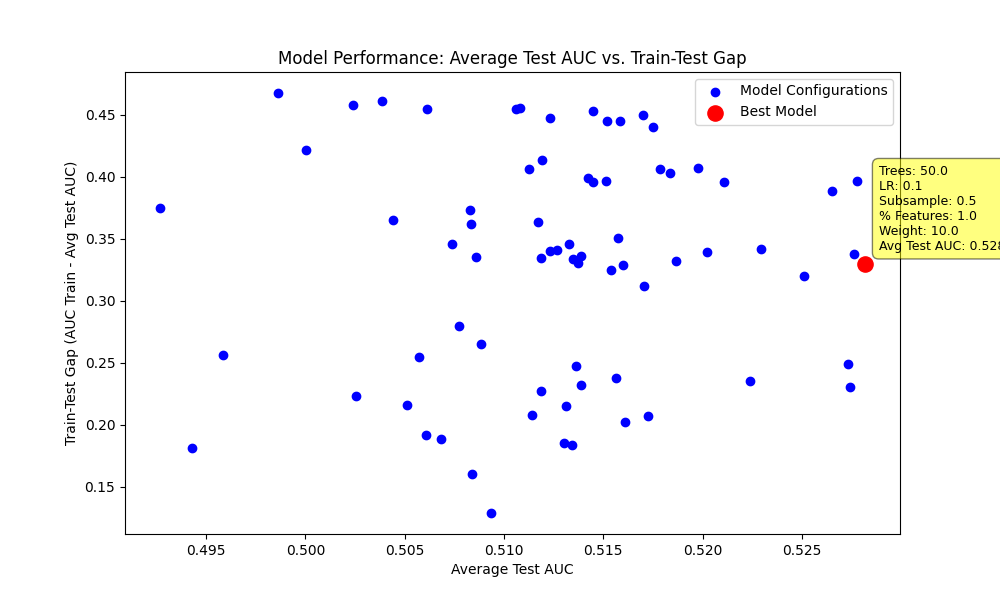

==================================================NKE==================================================


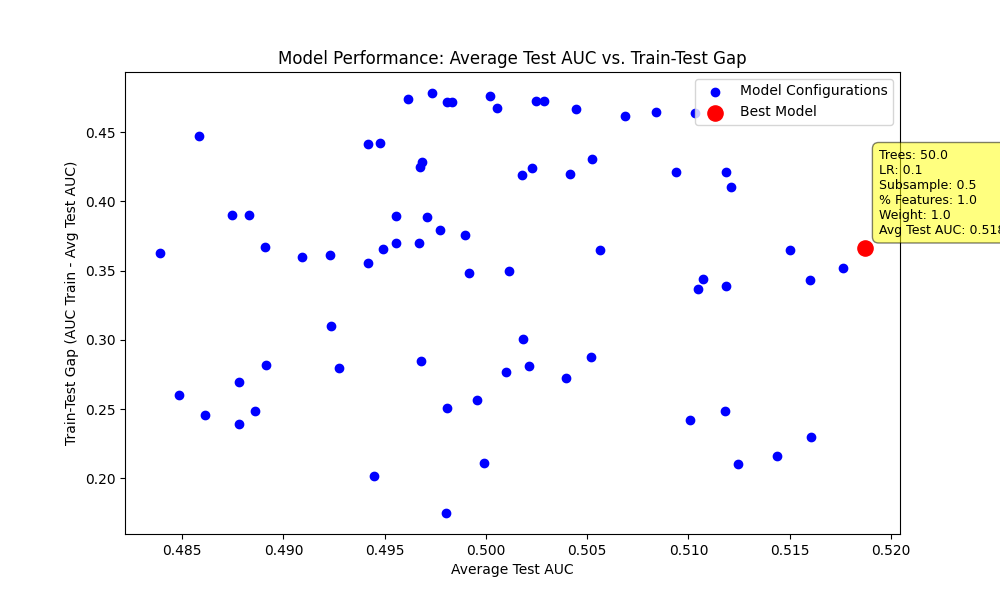

==================================================NVDA==================================================


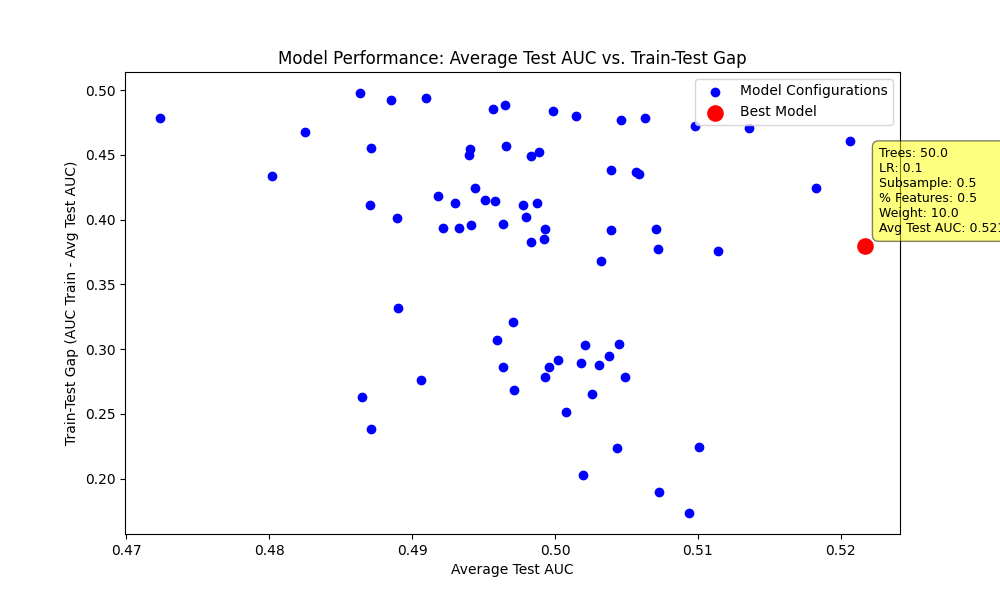

==================================================SPY==================================================


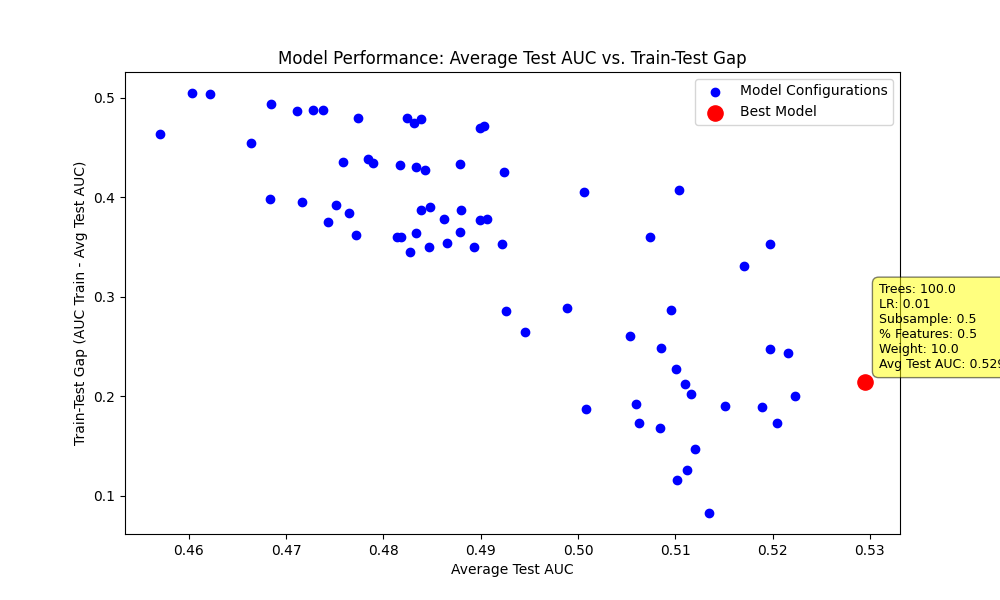

==================================================TSLA==================================================


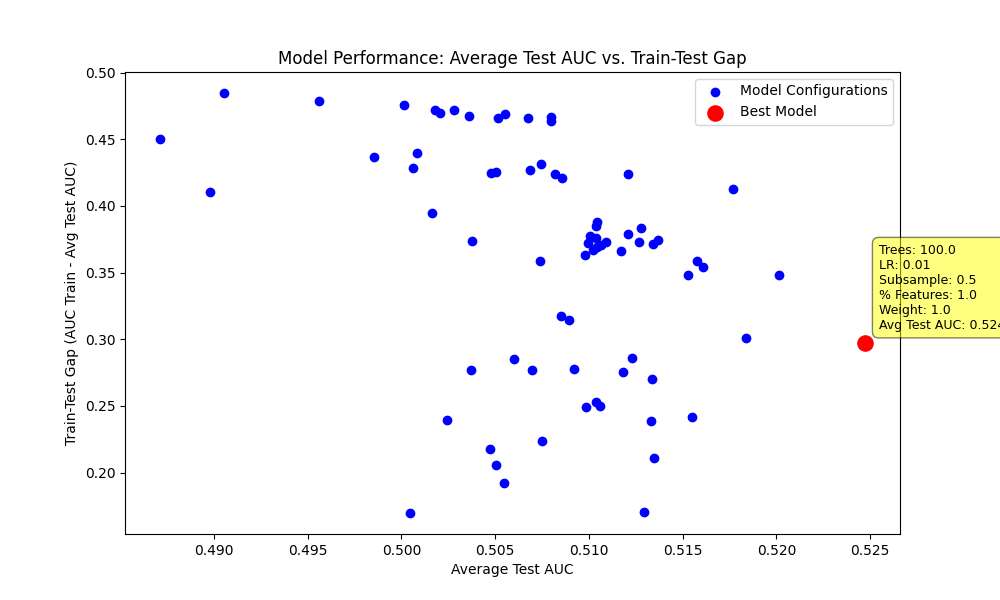

==================================================XOM==================================================


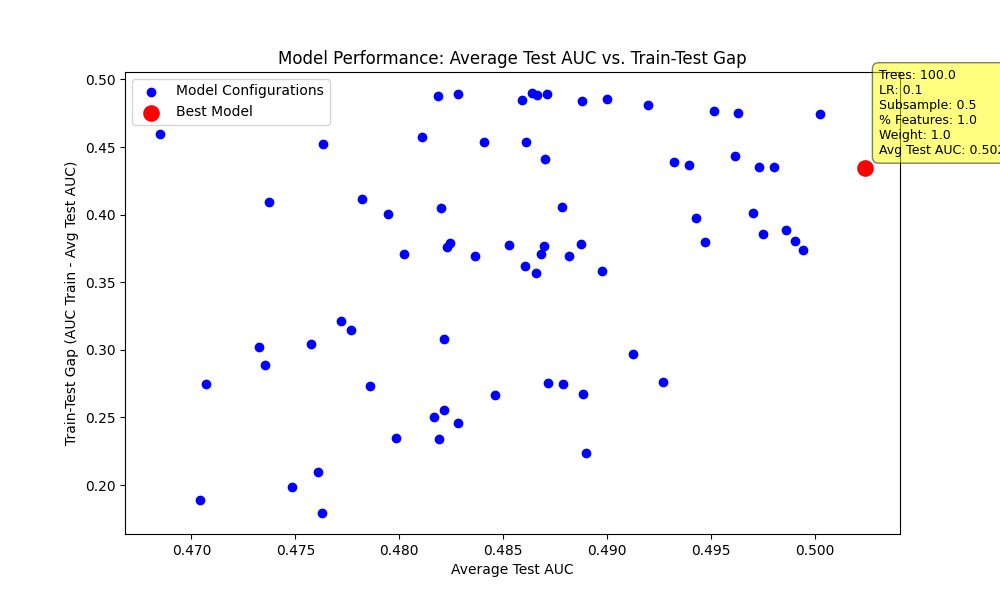

In [6]:
from setup import DataLoader
from steps import FILENAME
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from IPython.display import Image, display

''''''

data_loader = DataLoader(is_google_colab=False)
file_dict = data_loader.get_data_filepath_dict()
print(f'Total Number of Stocks & ETF: {len(file_dict.keys())}')
print(f'Stocks: {[i for i in list(file_dict.keys()) if i != "SPY"]}')
print(f'ETF: {[i for i in list(file_dict.keys()) if i == "SPY"]}')

algo_trading_bot_performance_colnames = ['total_return_percentage', 'win_rate_percentage', 'num_trades', 'sharpe_ratio', 'holding_period']

for stock_ticker in file_dict:
    # stock_ticker = 'AAPL'
    print(f'{"=" * 50}{stock_ticker}{"=" * 50}')
    # print(stock_ticker)
    stock_dir = os.path.join(data_loader.intermediate_data_dir, stock_ticker)
    param_plot = os.path.join(stock_dir, FILENAME.BEST_MODEL_PARAMS_PLOT)
    display(Image(param_plot))